In [1]:
import pandas as pd
import seaborn as sns
import keras.backend as K
import datetime
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import tensorflow as tf
import dash
import dash_core_components as dcc
import dash_html_components as html
import warnings
from dash.dependencies import Input, Output
from plotly.subplots import make_subplots
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense
from keras.layers import Embedding
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from keras.preprocessing.sequence import TimeseriesGenerator
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

/var/folders/_w/mzpp6g7s7wvgtrldps3jx8zc0000gn/T/ipykernel_60768/4200864875.py:11: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  import dash_core_components as dcc
/var/folders/_w/mzpp6g7s7wvgtrldps3jx8zc0000gn/T/ipykernel_60768/4200864875.py:12: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  import dash_html_components as html


In [2]:
df1 = pd.read_csv("/Users/_fangkhai/Documents/Academic/Computer Science Semester 7/Data Science Toolbox/Materials/Assignment Dataset/Dataset/tracks.csv")

In [3]:
df1

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,35iwgR4jXetI318WEWsa1Q,Carve,6,126903,0,['Uli'],['45tIt06XoI0Iio4LBEVpls'],1922-02-22,0.645,0.4450,0,-13.338,1,0.4510,0.674,0.744000,0.1510,0.1270,104.851,3
1,021ht4sdgPcrDgSk7JTbKY,Capítulo 2.16 - Banquero Anarquista,0,98200,0,['Fernando Pessoa'],['14jtPCOoNZwquk5wd9DxrY'],1922-06-01,0.695,0.2630,0,-22.136,1,0.9570,0.797,0.000000,0.1480,0.6550,102.009,1
2,07A5yehtSnoedViJAZkNnc,Vivo para Quererte - Remasterizado,0,181640,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.434,0.1770,1,-21.180,1,0.0512,0.994,0.021800,0.2120,0.4570,130.418,5
3,08FmqUhxtyLTn6pAh6bk45,El Prisionero - Remasterizado,0,176907,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.321,0.0946,7,-27.961,1,0.0504,0.995,0.918000,0.1040,0.3970,169.980,3
4,08y9GfoqCWfOGsKdwojr5e,Lady of the Evening,0,163080,0,['Dick Haymes'],['3BiJGZsyX9sJchTqcSA7Su'],1922,0.402,0.1580,3,-16.900,0,0.0390,0.989,0.130000,0.3110,0.1960,103.220,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586667,5rgu12WBIHQtvej2MdHSH0,云与海,50,258267,0,['阿YueYue'],['1QLBXKM5GCpyQQSVMNZqrZ'],2020-09-26,0.560,0.5180,0,-7.471,0,0.0292,0.785,0.000000,0.0648,0.2110,131.896,4
586668,0NuWgxEp51CutD2pJoF4OM,blind,72,153293,0,['ROLE MODEL'],['1dy5WNgIKQU6ezkpZs4y8z'],2020-10-21,0.765,0.6630,0,-5.223,1,0.0652,0.141,0.000297,0.0924,0.6860,150.091,4
586669,27Y1N4Q4U3EfDU5Ubw8ws2,What They'll Say About Us,70,187601,0,['FINNEAS'],['37M5pPGs6V1fchFJSgCguX'],2020-09-02,0.535,0.3140,7,-12.823,0,0.0408,0.895,0.000150,0.0874,0.0663,145.095,4
586670,45XJsGpFTyzbzeWK8VzR8S,A Day At A Time,58,142003,0,"['Gentle Bones', 'Clara Benin']","['4jGPdu95icCKVF31CcFKbS', '5ebPSE9YI5aLeZ1Z2g...",2021-03-05,0.696,0.6150,10,-6.212,1,0.0345,0.206,0.000003,0.3050,0.4380,90.029,4


In [4]:
df1["artists"] = df1["artists"].str.strip("[]")
df1["artists"] = df1["artists"].str.strip("''")

In [5]:
df1.describe()

,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,586672.000000,5.866720e+05,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000,586672.000000
mean,27.570053,2.300512e+05,0.044086,0.563594,0.542036,5.221603,-10.206067,0.658797,0.104864,0.449863,0.113451,0.213935,0.552292,118.464857,3.873382
std,18.370642,1.265261e+05,0.205286,0.166103,0.251923,3.519423,5.089328,0.474114,0.179893,0.348837,0.266868,0.184326,0.257671,29.764108,0.473162
min,0.000000,3.344000e+03,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,13.000000,1.750930e+05,0.000000,0.453000,0.343000,2.000000,-12.891000,0.000000,0.034000,0.096900,0.000000,0.098300,0.346000,95.600000,4.000000
50%,27.000000,2.148930e+05,0.000000,0.577000,0.549000,5.000000,-9.243000,1.000000,0.044300,0.422000,0.000024,0.139000,0.564000,117.384000,4.000000
75%,41.000000,2.638670e+05,0.000000,0.686000,0.748000,8.000000,-6.482000,1.000000,0.076300,0.785000,0.009550,0.278000,0.769000,136.321000,4.000000
max,100.000000,5.621218e+06,1.000000,0.991000,1.000000,11.000000,5.376000,1.000000,0.971000,0.996000,1.000000,1.000000,1.000000,246.381000,5.000000


In [6]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 586672 entries, 0 to 586671
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   id                586672 non-null  object 
 1   name              586601 non-null  object 
 2   popularity        586672 non-null  int64  
 3   duration_ms       586672 non-null  int64  
 4   explicit          586672 non-null  int64  
 5   artists           586672 non-null  object 
 6   id_artists        586672 non-null  object 
 7   release_date      586672 non-null  object 
 8   danceability      586672 non-null  float64
 9   energy            586672 non-null  float64
 10  key               586672 non-null  int64  
 11  loudness          586672 non-null  float64
 12  mode              586672 non-null  int64  
 13  speechiness       586672 non-null  float64
 14  acousticness      586672 non-null  float64
 15  instrumentalness  586672 non-null  float64
 16  liveness          58

In [7]:
df1.isnull().sum()

id                   0
name                71
popularity           0
duration_ms          0
explicit             0
artists              0
id_artists           0
release_date         0
danceability         0
energy               0
key                  0
loudness             0
mode                 0
speechiness          0
acousticness         0
instrumentalness     0
liveness             0
valence              0
tempo                0
time_signature       0
dtype: int64

In [8]:
df1.dropna(subset = ["name"], inplace = True)

In [9]:
df1.isnull().sum()

id                  0
name                0
popularity          0
duration_ms         0
explicit            0
artists             0
id_artists          0
release_date        0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
dtype: int64

In [10]:
duplicates = df1[df1["name"].duplicated()]
if duplicates.empty:
    print("There're no duplicates")
else:
    print("There're duplicates")

There're duplicates


In [11]:
df1 = df1.drop_duplicates(subset = ["name"])

In [12]:
duplicates = df1[df1["name"].duplicated()]
if duplicates.empty:
    print("There're no duplicates")
else:
    print("There're duplicates")

There're no duplicates


In [13]:
df1

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,35iwgR4jXetI318WEWsa1Q,Carve,6,126903,0,Uli,['45tIt06XoI0Iio4LBEVpls'],1922-02-22,0.645,0.4450,0,-13.338,1,0.4510,0.674,0.744000,0.1510,0.1270,104.851,3
1,021ht4sdgPcrDgSk7JTbKY,Capítulo 2.16 - Banquero Anarquista,0,98200,0,Fernando Pessoa,['14jtPCOoNZwquk5wd9DxrY'],1922-06-01,0.695,0.2630,0,-22.136,1,0.9570,0.797,0.000000,0.1480,0.6550,102.009,1
2,07A5yehtSnoedViJAZkNnc,Vivo para Quererte - Remasterizado,0,181640,0,Ignacio Corsini,['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.434,0.1770,1,-21.180,1,0.0512,0.994,0.021800,0.2120,0.4570,130.418,5
3,08FmqUhxtyLTn6pAh6bk45,El Prisionero - Remasterizado,0,176907,0,Ignacio Corsini,['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.321,0.0946,7,-27.961,1,0.0504,0.995,0.918000,0.1040,0.3970,169.980,3
4,08y9GfoqCWfOGsKdwojr5e,Lady of the Evening,0,163080,0,Dick Haymes,['3BiJGZsyX9sJchTqcSA7Su'],1922,0.402,0.1580,3,-16.900,0,0.0390,0.989,0.130000,0.3110,0.1960,103.220,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586665,0SjsIzJkZfDU7wlcdklEFR,John Brown's Song,66,185250,0,Gregory Oberle,['4MxqhahGRT4BPz1PilXGeu'],2020-03-20,0.562,0.0331,1,-25.551,1,0.1030,0.996,0.961000,0.1110,0.3860,63.696,3
586667,5rgu12WBIHQtvej2MdHSH0,云与海,50,258267,0,阿YueYue,['1QLBXKM5GCpyQQSVMNZqrZ'],2020-09-26,0.560,0.5180,0,-7.471,0,0.0292,0.785,0.000000,0.0648,0.2110,131.896,4
586668,0NuWgxEp51CutD2pJoF4OM,blind,72,153293,0,ROLE MODEL,['1dy5WNgIKQU6ezkpZs4y8z'],2020-10-21,0.765,0.6630,0,-5.223,1,0.0652,0.141,0.000297,0.0924,0.6860,150.091,4
586669,27Y1N4Q4U3EfDU5Ubw8ws2,What They'll Say About Us,70,187601,0,FINNEAS,['37M5pPGs6V1fchFJSgCguX'],2020-09-02,0.535,0.3140,7,-12.823,0,0.0408,0.895,0.000150,0.0874,0.0663,145.095,4


In [14]:
columns_to_drop = ["id", "id_artists", "mode", "time_signature"]
df1 = df1.drop(columns = columns_to_drop)

In [15]:
df1

,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,Carve,6,126903,0,Uli,1922-02-22,0.645,0.4450,0,-13.338,0.4510,0.674,0.744000,0.1510,0.1270,104.851
1,Capítulo 2.16 - Banquero Anarquista,0,98200,0,Fernando Pessoa,1922-06-01,0.695,0.2630,0,-22.136,0.9570,0.797,0.000000,0.1480,0.6550,102.009
2,Vivo para Quererte - Remasterizado,0,181640,0,Ignacio Corsini,1922-03-21,0.434,0.1770,1,-21.180,0.0512,0.994,0.021800,0.2120,0.4570,130.418
3,El Prisionero - Remasterizado,0,176907,0,Ignacio Corsini,1922-03-21,0.321,0.0946,7,-27.961,0.0504,0.995,0.918000,0.1040,0.3970,169.980
4,Lady of the Evening,0,163080,0,Dick Haymes,1922,0.402,0.1580,3,-16.900,0.0390,0.989,0.130000,0.3110,0.1960,103.220
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586665,John Brown's Song,66,185250,0,Gregory Oberle,2020-03-20,0.562,0.0331,1,-25.551,0.1030,0.996,0.961000,0.1110,0.3860,63.696
586667,云与海,50,258267,0,阿YueYue,2020-09-26,0.560,0.5180,0,-7.471,0.0292,0.785,0.000000,0.0648,0.2110,131.896
586668,blind,72,153293,0,ROLE MODEL,2020-10-21,0.765,0.6630,0,-5.223,0.0652,0.141,0.000297,0.0924,0.6860,150.091
586669,What They'll Say About Us,70,187601,0,FINNEAS,2020-09-02,0.535,0.3140,7,-12.823,0.0408,0.895,0.000150,0.0874,0.0663,145.095


In [16]:
df2 = pd.read_csv("/Users/_fangkhai/Documents/Academic/Computer Science Semester 7/Data Science Toolbox/Materials/Assignment Dataset/Dataset/artists.csv")

In [17]:
df2

,id,followers,genres,name,popularity
0,0DheY5irMjBUeLybbCUEZ2,0.0,[],Armid & Amir Zare Pashai feat. Sara Rouzbehani,0
1,0DlhY15l3wsrnlfGio2bjU,5.0,[],ปูนา ภาวิณี,0
2,0DmRESX2JknGPQyO15yxg7,0.0,[],Sadaa,0
3,0DmhnbHjm1qw6NCYPeZNgJ,0.0,[],Tra'gruda,0
4,0Dn11fWM7vHQ3rinvWEl4E,2.0,[],Ioannis Panoutsopoulos,0
...,...,...,...,...,...
1162090,3cOzi726Iav1toV2LRVEjp,4831.0,['black comedy'],Ali Siddiq,34
1162091,6LogY6VMM3jgAE6fPzXeMl,46.0,[],Rodney Laney,2
1162092,19boQkDEIay9GaVAWkUhTa,257.0,[],Blake Wexler,10
1162093,5nvjpU3Y7L6Hpe54QuvDjy,2357.0,['black comedy'],Donnell Rawlings,15


In [18]:
df2.rename(columns = {"name" : "artists"}, inplace = True)
df2

,id,followers,genres,artists,popularity
0,0DheY5irMjBUeLybbCUEZ2,0.0,[],Armid & Amir Zare Pashai feat. Sara Rouzbehani,0
1,0DlhY15l3wsrnlfGio2bjU,5.0,[],ปูนา ภาวิณี,0
2,0DmRESX2JknGPQyO15yxg7,0.0,[],Sadaa,0
3,0DmhnbHjm1qw6NCYPeZNgJ,0.0,[],Tra'gruda,0
4,0Dn11fWM7vHQ3rinvWEl4E,2.0,[],Ioannis Panoutsopoulos,0
...,...,...,...,...,...
1162090,3cOzi726Iav1toV2LRVEjp,4831.0,['black comedy'],Ali Siddiq,34
1162091,6LogY6VMM3jgAE6fPzXeMl,46.0,[],Rodney Laney,2
1162092,19boQkDEIay9GaVAWkUhTa,257.0,[],Blake Wexler,10
1162093,5nvjpU3Y7L6Hpe54QuvDjy,2357.0,['black comedy'],Donnell Rawlings,15


In [19]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1162095 entries, 0 to 1162094
Data columns (total 5 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   id          1162095 non-null  object 
 1   followers   1162084 non-null  float64
 2   genres      1162095 non-null  object 
 3   artists     1162095 non-null  object 
 4   popularity  1162095 non-null  int64  
dtypes: float64(1), int64(1), object(3)
memory usage: 44.3+ MB


In [20]:
df2.describe()

,followers,popularity
count,1.162084e+06,1.162095e+06
mean,1.022070e+04,8.795961e+00
std,2.543995e+05,1.355777e+01
min,0.000000e+00,0.000000e+00
25%,1.000000e+01,0.000000e+00
50%,5.700000e+01,2.000000e+00
75%,4.170000e+02,1.300000e+01
max,7.890023e+07,1.000000e+02


In [21]:
df2.isnull().sum()

id             0
followers     11
genres         0
artists        0
popularity     0
dtype: int64

In [22]:
df2["followers"].fillna(df2["followers"].mean, inplace = True)

In [23]:
df2.isnull().sum()

id            0
followers     0
genres        0
artists       0
popularity    0
dtype: int64

In [24]:
duplicates = df2[df2["artists"].duplicated()]
if duplicates.empty:
    print("There're no duplicates")
else:
    print("There're duplicates")

There're duplicates


In [25]:
df2 = df2.drop_duplicates(subset = ["artists"])

In [26]:
duplicates = df2[df2["artists"].duplicated()]
if duplicates.empty:
    print("There're no duplicates")
else:
    print("There're duplicates")

There're no duplicates


In [27]:
columns_to_drop = ["id", "genres"]
df2 = df2.drop(columns = columns_to_drop)

In [28]:
df2

,followers,artists,popularity
0,0.0,Armid & Amir Zare Pashai feat. Sara Rouzbehani,0
1,5.0,ปูนา ภาวิณี,0
2,0.0,Sadaa,0
3,0.0,Tra'gruda,0
4,2.0,Ioannis Panoutsopoulos,0
...,...,...,...
1162090,4831.0,Ali Siddiq,34
1162091,46.0,Rodney Laney,2
1162092,257.0,Blake Wexler,10
1162093,2357.0,Donnell Rawlings,15


In [29]:
df3 = pd.merge(df1, df2, on = "artists")

In [30]:
df3

,name,popularity_x,duration_ms,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,followers,popularity_y
0,Carve,6,126903,0,Uli,1922-02-22,0.645,0.44500,0,-13.338,0.4510,0.674,0.744000,0.1510,0.127,104.851,91.0,4
1,Lazy Boi,0,157333,0,Uli,1922-02-22,0.298,0.46000,1,-18.645,0.4530,0.521,0.856000,0.4360,0.402,87.921,91.0,4
2,Sketch,0,87040,0,Uli,1922-02-22,0.634,0.00399,5,-29.973,0.0377,0.926,0.919000,0.1050,0.396,79.895,91.0,4
3,L'enfer,0,40000,0,Uli,1922-02-22,0.657,0.32500,10,-14.319,0.2540,0.199,0.856000,0.0931,0.105,81.944,91.0,4
4,Graphite,0,104400,0,Uli,1922-02-22,0.644,0.68400,7,-8.247,0.1990,0.144,0.802000,0.0847,0.138,100.031,91.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
351773,The Cutest Puppy,67,82500,0,Laureen Conrad,2020-10-30,0.609,0.01720,8,-28.573,0.1180,0.996,0.973000,0.1080,0.890,68.619,23.0,52
351774,同行 (新加坡電視劇《愛...沒有距離》主題曲),43,205238,0,Boon Hui Lu,2020-03-03,0.743,0.67900,8,-3.952,0.0323,0.269,0.000000,0.1330,0.395,126.070,36088.0,49
351775,John Brown's Song,66,185250,0,Gregory Oberle,2020-03-20,0.562,0.03310,1,-25.551,0.1030,0.996,0.961000,0.1110,0.386,63.696,91.0,55
351776,云与海,50,258267,0,阿YueYue,2020-09-26,0.560,0.51800,0,-7.471,0.0292,0.785,0.000000,0.0648,0.211,131.896,896.0,38


In [31]:
df3.isnull().sum()

name                0
popularity_x        0
duration_ms         0
explicit            0
artists             0
release_date        0
danceability        0
energy              0
key                 0
loudness            0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
followers           0
popularity_y        0
dtype: int64

In [32]:
df3["duration_ms"] = df3["duration_ms"] / 60000
df3

,name,popularity_x,duration_ms,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,followers,popularity_y
0,Carve,6,2.115050,0,Uli,1922-02-22,0.645,0.44500,0,-13.338,0.4510,0.674,0.744000,0.1510,0.127,104.851,91.0,4
1,Lazy Boi,0,2.622217,0,Uli,1922-02-22,0.298,0.46000,1,-18.645,0.4530,0.521,0.856000,0.4360,0.402,87.921,91.0,4
2,Sketch,0,1.450667,0,Uli,1922-02-22,0.634,0.00399,5,-29.973,0.0377,0.926,0.919000,0.1050,0.396,79.895,91.0,4
3,L'enfer,0,0.666667,0,Uli,1922-02-22,0.657,0.32500,10,-14.319,0.2540,0.199,0.856000,0.0931,0.105,81.944,91.0,4
4,Graphite,0,1.740000,0,Uli,1922-02-22,0.644,0.68400,7,-8.247,0.1990,0.144,0.802000,0.0847,0.138,100.031,91.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
351773,The Cutest Puppy,67,1.375000,0,Laureen Conrad,2020-10-30,0.609,0.01720,8,-28.573,0.1180,0.996,0.973000,0.1080,0.890,68.619,23.0,52
351774,同行 (新加坡電視劇《愛...沒有距離》主題曲),43,3.420633,0,Boon Hui Lu,2020-03-03,0.743,0.67900,8,-3.952,0.0323,0.269,0.000000,0.1330,0.395,126.070,36088.0,49
351775,John Brown's Song,66,3.087500,0,Gregory Oberle,2020-03-20,0.562,0.03310,1,-25.551,0.1030,0.996,0.961000,0.1110,0.386,63.696,91.0,55
351776,云与海,50,4.304450,0,阿YueYue,2020-09-26,0.560,0.51800,0,-7.471,0.0292,0.785,0.000000,0.0648,0.211,131.896,896.0,38


In [33]:
df3.rename(columns = {"duration_ms" : "duration", "popularity_x" : "popularity"}, inplace = True)
df3.drop(columns = "popularity_y", inplace = True)

In [34]:
df3

,name,popularity,duration,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,followers
0,Carve,6,2.115050,0,Uli,1922-02-22,0.645,0.44500,0,-13.338,0.4510,0.674,0.744000,0.1510,0.127,104.851,91.0
1,Lazy Boi,0,2.622217,0,Uli,1922-02-22,0.298,0.46000,1,-18.645,0.4530,0.521,0.856000,0.4360,0.402,87.921,91.0
2,Sketch,0,1.450667,0,Uli,1922-02-22,0.634,0.00399,5,-29.973,0.0377,0.926,0.919000,0.1050,0.396,79.895,91.0
3,L'enfer,0,0.666667,0,Uli,1922-02-22,0.657,0.32500,10,-14.319,0.2540,0.199,0.856000,0.0931,0.105,81.944,91.0
4,Graphite,0,1.740000,0,Uli,1922-02-22,0.644,0.68400,7,-8.247,0.1990,0.144,0.802000,0.0847,0.138,100.031,91.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
351773,The Cutest Puppy,67,1.375000,0,Laureen Conrad,2020-10-30,0.609,0.01720,8,-28.573,0.1180,0.996,0.973000,0.1080,0.890,68.619,23.0
351774,同行 (新加坡電視劇《愛...沒有距離》主題曲),43,3.420633,0,Boon Hui Lu,2020-03-03,0.743,0.67900,8,-3.952,0.0323,0.269,0.000000,0.1330,0.395,126.070,36088.0
351775,John Brown's Song,66,3.087500,0,Gregory Oberle,2020-03-20,0.562,0.03310,1,-25.551,0.1030,0.996,0.961000,0.1110,0.386,63.696,91.0
351776,云与海,50,4.304450,0,阿YueYue,2020-09-26,0.560,0.51800,0,-7.471,0.0292,0.785,0.000000,0.0648,0.211,131.896,896.0


/var/folders/_w/mzpp6g7s7wvgtrldps3jx8zc0000gn/T/ipykernel_60768/4261142191.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = df3.corr()


<Axes: >

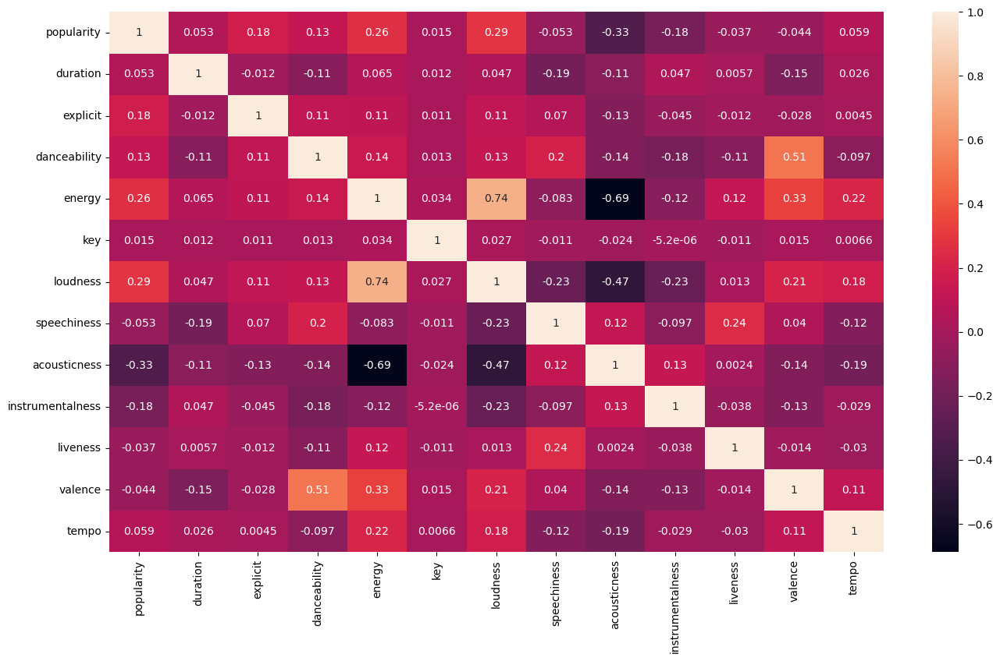

In [35]:
corr = df3.corr()
plt.figure(figsize = (16, 9))
sns.heatmap(corr, annot = True)

In [36]:
timeFrames = []

n = 1
while n <= 93:
    timeFrames.append(n)
    n += 1

In [37]:
def calculate_popularity_within_timeframe(df3, timeframe):
    return df3[(df3["duration"] <= timeframe) & (df3["duration"] >= timeframe - 1)]["popularity"].mean()

In [38]:
calculate_popularity = [calculate_popularity_within_timeframe(df3, timeframe) for timeframe in timeFrames]
results_df = pd.DataFrame({'Timeframe (minutes)': timeFrames, 'Popularity': calculate_popularity})

In [39]:
fig = go.Figure()

scatter_trace = go.Scatter(
    x=results_df['Timeframe (minutes)'][:1],
    y=results_df['Popularity'][:1],
    mode='markers',
    name='Scatter',
    marker=dict(color='blue'),
    text=results_df['Timeframe (minutes)'][:1],
    hoverinfo='x+y+text',
)
fig.add_trace(scatter_trace)

line_trace = go.Scatter(
    x=[],
    y=[],
    mode='lines',
    name='Line',
    line=dict(color='red'),
    showlegend=False,
)
fig.add_trace(line_trace)

fig.update_layout(
    title='Popularity Based on The Duration',
    xaxis_title='Duration (minutes)',
    yaxis_title='Average Popularity',
    legend_title='Legend',
    hovermode='closest',
)

frames = [go.Frame(
    data=[
        go.Scatter(
            x=results_df['Timeframe (minutes)'][:frame + 1],
            y=results_df['Popularity'][:frame + 1],
            mode='markers',
            text=results_df['Timeframe (minutes)'][:frame + 1],
            marker=dict(color='blue'),
            hoverinfo='x+y+text',
        ),
        go.Scatter(
            x=results_df['Timeframe (minutes)'][:frame + 1],
            y=results_df['Popularity'][:frame + 1],
            mode='lines',
            line=dict(color='red'),
            showlegend=False,
        ),
    ],
    name=str(frame),
) for frame in range(1, len(results_df))]

updatemenu = [
    {
        "buttons": [
            {
                "args": [None, {"frame": {"duration": 100, "redraw": True}, "fromcurrent": True}],
                "label": "Play",
                "method": "animate",
            },
            {
                "args": [[None], {"frame": {"duration": 0, "redraw": False}, "mode": "immediate"}],
                "label": "Pause",
                "method": "animate",
            },
        ],
        "direction": "left",
        "pad": {"r": 10, "t": 87},
        "showactive": False,
        "type": "buttons",
        "x": 0.1,
        "xanchor": "right",
        "y": 0,
        "yanchor": "top",
    }
]

fig.update(frames=frames)
fig.update_layout(updatemenus=updatemenu)
fig.show()

In [40]:
scatter_fig = px.scatter(
    results_df,
    x='Timeframe (minutes)',
    y='Popularity',
    labels={'Timeframe (minutes)': 'Duration (minutes)', 'Popularity': 'Average Popularity'},
    color_discrete_sequence=['blue'],
    hover_name='Timeframe (minutes)',
)

trendline_trace = px.scatter(
    results_df,
    x='Timeframe (minutes)',
    y='Popularity',
    trendline='ols',
    custom_data=['Timeframe (minutes)'],
    color_discrete_sequence=['red'],
).data[1]

scatter_fig.add_trace(trendline_trace)
scatter_fig.data[1].visible = 'legendonly'

scatter_fig.update_layout(
    xaxis_title='Duration (minutes)',
    yaxis_title='Average Popularity',
    legend_title='Legend',
    hovermode='closest',
    title='Average Popularity vs Duration (minutes)'
)

fixed_title = 'Average Popularity vs Duration (minutes)'

updatemenu = [
    {
        "buttons": [
            {
                "args": [{"visible": [True, False]}, {"title": fixed_title}],
                "label": "Hide Trendline",
                "method": "update",
            },
            {
                "args": [{"visible": [True, True]}, {"title": fixed_title}],
                "label": "Show Trendline",
                "method": "update",
            },
        ],
        "direction": "down",
        "showactive": False,
        "x": 0.05,
        "xanchor": "left",
        "y": 0.05,
        "yanchor": "bottom",
    }
]

scatter_fig.update_layout(
    updatemenus=updatemenu,
)

scatter_fig.show()

In [41]:
corr = df3.drop(['popularity'], axis=1).corrwith(df3["popularity"]).abs().sort_values(ascending=False)

fig = px.bar(
    x=corr.values[::-1],
    y=corr.index[::-1],
    labels={'x': 'Feature Importance', 'y': 'Features'},
    title='Feature Importance Based On Popularity',
    orientation='h',
    color=corr.values[::-1],
    color_continuous_scale='viridis',
)

fig.update_layout(
    margin=dict(l=20, r=20, t=50, b=20),
)

frames = [go.Frame(
    data=[go.Bar(
        x=corr.values[::-1][:i + 1],
        y=corr.index[::-1][:i + 1],
        orientation='h',
        marker=dict(color=corr.values[::-1][:i + 1], colorscale='viridis'),
    )],
    name=str(i)
) for i in range(1, len(corr) + 1)]

fig.frames = frames
fig.update_layout(updatemenus=[
    {
        "buttons": [
            {
                "args": [None, {"frame": {"duration": 1000, "redraw": True}, "fromcurrent": True}],
                "label": "Play",
                "method": "animate",
            },
            {
                "args": [[None], {"frame": {"duration": 0, "redraw": True}, "mode": "immediate"}],
                "label": "Pause",
                "method": "animate",
            },
        ],
        "direction": "right",
        "showactive": False,
        "type": "buttons",
        "x": 1.0,
        "xanchor": "right",
        "y": -0.2,
        "yanchor": "bottom",
    }
])

fig.update_layout(updatemenus=[{"buttons": [], "direction": "right", "showactive": False, "type": "buttons", "x": 1.0, "xanchor": "right", "y": -0.2, "yanchor": "bottom"}])

fig.show()

/var/folders/_w/mzpp6g7s7wvgtrldps3jx8zc0000gn/T/ipykernel_60768/723654473.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corrwith is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



In [42]:
df3['release_date'] = pd.to_datetime(df3['release_date'])
df3['year'] = df3['release_date'].dt.year
df3['year_group'] = pd.cut(df3['year'], bins=range(1920, 2024, 5),
                           labels=[f'{y}-{y+4}' for y in range(1920, 2020, 5)])

grouped_data = df3.groupby(['year_group', 'explicit'])['popularity'].mean().unstack().reset_index()

fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'bar'}]])

not_explicit_color = 'rgba(255, 192, 203, 1)'
explicit_color = 'rgba(255, 215, 0, 0.8)'

fig.add_trace(go.Bar(
    x=grouped_data['year_group'],
    y=[None] * len(grouped_data),
    marker=dict(color=not_explicit_color),
    name='Not Explicit (0)',
))

fig.add_trace(go.Bar(
    x=grouped_data['year_group'],
    y=[None] * len(grouped_data),
    marker=dict(color='rgba(100, 100, 100, 0.2)'),
    name='Explicit (1)',
))

fig.add_trace(go.Scatter(
    x=grouped_data['year_group'],
    y=grouped_data[0],
    mode='lines+markers',
    name='Not Explicit (0)',
    line=dict(color=not_explicit_color)
))

fig.add_trace(go.Scatter(
    x=grouped_data['year_group'],
    y=grouped_data[1],
    mode='lines+markers',
    name='Explicit (1)',
    line=dict(color=explicit_color)  
))

fig.update_xaxes(title_text='Year Group')
fig.update_yaxes(title_text='Average Popularity')

frames = [go.Frame(
    data=[
        go.Bar(
            x=grouped_data['year_group'],
            y=grouped_data[0] if step % 2 == 0 else grouped_data[0],
            marker=dict(color=not_explicit_color if step % 2 == 0 else 'rgba(192, 192, 192, 1)'),
            name='Not Explicit (0)',
        ),
        go.Bar(
            x=grouped_data['year_group'],
            y=grouped_data[1] if step % 2 == 1 else grouped_data[1],
            marker=dict(color='rgba(0, 0, 0, 1)' if step % 2 == 1 else explicit_color),
            name='Explicit (1)',
        ),
    ],
    name=f"Step {step}",
) for step in range(2)]

animation_settings = {
    'frame': {'duration': 1000},
    'fromcurrent': True,
    'transition': {'duration': 1000},
}

fig.update_traces(selector=dict(name='Not Explicit (0)'), overwrite=True)
fig.update_traces(selector=dict(name='Explicit (1)'), overwrite=True)

fig.update(frames=frames)
fig.update_layout(updatemenus=[
    {
        'type': 'buttons',
        'showactive': False,
        'buttons': [
            {
                'label': 'Play',
                'method': 'animate',
                'args': [None, animation_settings],
            },
            {
                'label': 'Pause',
                'method': 'animate',
                'args': [[None], animation_settings],
            },
        ],
    },
])
fig.show()

In [43]:
df3['cluster'] = (df3['popularity'] // 10).astype(int)

In [44]:
cluster_stats = df3.groupby('cluster').agg({'popularity': 'mean', 'name': 'count'}).reset_index()
cluster_stats.rename(columns = {'popularity': 'Mean Popularity', 'name': 'Number of Songs'}, inplace = True)

fig = px.scatter(
    cluster_stats,
    x = 'cluster',
    y = 'Mean Popularity',
    size = 'Number of Songs',  
    color = 'Number of Songs', 
    labels = {'cluster': 'Cluster', 'Mean Popularity': 'Mean Popularity', 'Number of Songs': 'Number of Songs'},
    title = 'Song Clusters by Popularity',
    hover_name = 'cluster',
    size_max = 40,
    color_continuous_scale = 'Rainbow'
)

fig.update_xaxes(title_text = 'Cluster')
fig.update_yaxes(title_text = 'Mean Popularity')
fig.show()

In [45]:
cluster_8_songs = df3[df3['cluster'] == 8]

print(f"Songs in Cluster 8:")
for song in cluster_8_songs['name']:
    print(f"- {song}")

Songs in Cluster 8:
- Here Comes The Sun - Remastered 2009
- My Girl
- Brown Eyed Girl
- Fortunate Son
- Dreams - 2004 Remaster
- The Chain - 2004 Remaster
- Your Song
- Tiny Dancer
- Rocket Man (I Think It's Going To Be A Long, Long Time)
- I'm Still Standing
- Hotel California - 2013 Remaster
- Billie Jean
- Beat It
- Sweet Home Alabama
- Three Little Birds
- Dancing Queen
- Bohemian Rhapsody - Remastered 2011
- We Will Rock You - Remastered
- Don't Stop Me Now - Remastered 2011
- Another One Bites The Dust - Remastered 2011
- September
- I Was Made For Lovin' You
- Don't Stop Believin'
- More Than a Feeling
- Highway to Hell
- Back In Black
- You Shook Me All Night Long
- Thunderstruck
- Should I Stay or Should I Go - Remastered
- Sultans Of Swing
- Africa
- Every Breath You Take
- Jump - 2015 Remaster
- With Or Without You - Remastered
- I Still Haven't Found What I'm Looking For
- Summer Of '69
- Losing My Religion
- Wake Me Up Before You Go-Go
- Enter Sandman
- Nothing Else Matte

In [46]:
average_duration_cluster_8 = cluster_8_songs['duration'].mean()
print(f"Average Duration for Cluster 8 Songs: {average_duration_cluster_8:.2f} minutes")

Average Duration for Cluster 8 Songs: 3.50 minutes


In [47]:
warnings.filterwarnings("ignore")
X = df3[['duration', 'popularity']]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

K = 15 

kmeans = KMeans(n_clusters=K, random_state=42)
df3['cluster'] = kmeans.fit_predict(X_scaled)
cluster_centers = scaler.inverse_transform(kmeans.cluster_centers_)

for i, center in enumerate(cluster_centers):
    print(f"Cluster {i+1} Center - Duration: {center[0]:.2f} minutes, Popularity: {center[1]:.2f}")

Cluster 1 Center - Duration: 4.09 minutes, Popularity: 11.54
Cluster 2 Center - Duration: 3.40 minutes, Popularity: 49.28
Cluster 3 Center - Duration: 9.02 minutes, Popularity: 28.41
Cluster 4 Center - Duration: 32.79 minutes, Popularity: 16.87
Cluster 5 Center - Duration: 3.67 minutes, Popularity: 64.39
Cluster 6 Center - Duration: 2.28 minutes, Popularity: 15.88
Cluster 7 Center - Duration: 61.70 minutes, Popularity: 15.65
Cluster 8 Center - Duration: 1.72 minutes, Popularity: 32.97
Cluster 9 Center - Duration: 5.38 minutes, Popularity: 45.59
Cluster 10 Center - Duration: 17.11 minutes, Popularity: 20.44
Cluster 11 Center - Duration: 5.09 minutes, Popularity: 27.28
Cluster 12 Center - Duration: 6.30 minutes, Popularity: 9.12
Cluster 13 Center - Duration: 3.71 minutes, Popularity: 37.11
Cluster 14 Center - Duration: 2.80 minutes, Popularity: 2.57
Cluster 15 Center - Duration: 3.47 minutes, Popularity: 24.58


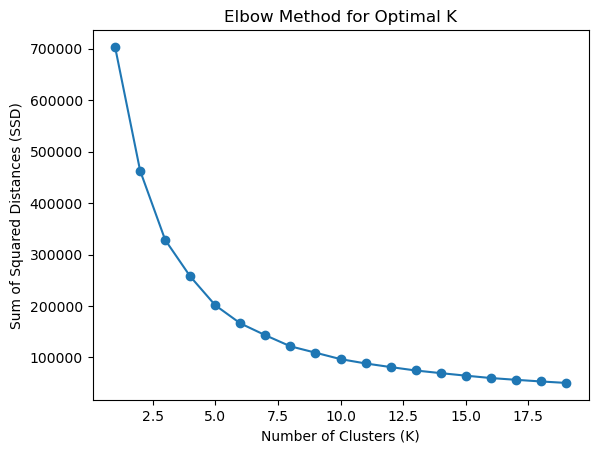

In [48]:
warnings.filterwarnings("ignore")
ssd = []
K_range = range(1, 20)

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    ssd.append(kmeans.inertia_)

plt.plot(K_range, ssd, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Sum of Squared Distances (SSD)')
plt.title('Elbow Method for Optimal K')
plt.show()

In [49]:
warnings.filterwarnings("ignore")
X = df3[['duration', 'popularity']]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

K = 8 

kmeans = KMeans(n_clusters=K, random_state=42)
df3['cluster'] = kmeans.fit_predict(X_scaled)
cluster_centers = scaler.inverse_transform(kmeans.cluster_centers_)

for i, center in enumerate(cluster_centers):
    print(f"Cluster {i+1} Center - Duration: {center[0]:.2f} minutes, Popularity: {center[1]:.2f}")
    
clustered_data = df3.copy()
fig = px.scatter_3d(clustered_data, x='duration', y='popularity', z='cluster',
                     color='cluster', opacity=0.7, size_max=10,
                     title='K-Means Clustering of Songs',
                     labels={'duration': 'Duration', 'popularity': 'Popularity', 'cluster': 'Cluster'},
                     hover_data=['cluster'])

fig.update_traces(marker=dict(size=5))
fig.update_layout(scene=dict(zaxis=dict(range=[0, K])))
fig.show()

Cluster 1 Center - Duration: 4.16 minutes, Popularity: 38.52
Cluster 2 Center - Duration: 2.33 minutes, Popularity: 28.41
Cluster 3 Center - Duration: 52.82 minutes, Popularity: 17.04
Cluster 4 Center - Duration: 3.68 minutes, Popularity: 56.73
Cluster 5 Center - Duration: 7.79 minutes, Popularity: 25.45
Cluster 6 Center - Duration: 2.89 minutes, Popularity: 5.61
Cluster 7 Center - Duration: 19.94 minutes, Popularity: 19.63
Cluster 8 Center - Duration: 4.36 minutes, Popularity: 18.95


In [50]:
df3.sort_values(by = "followers", ascending = False)

,name,popularity,duration,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,followers,year,year_group,cluster
190229,Lego House - Acoustic,49,3.116117,0,Ed Sheeran,2011-11-11,0.600,0.230,4,-8.576,0.1280,0.7660,0.000000,0.0963,0.285,149.636,78900234.0,2011,2010-2014,3
190207,All of the Stars,68,3.916450,0,Ed Sheeran,2014-05-19,0.436,0.562,11,-6.106,0.0278,0.0102,0.000278,0.1980,0.240,150.066,78900234.0,2014,2010-2014,3
190214,What Do I Know?,70,3.955550,0,Ed Sheeran,2017-03-03,0.838,0.492,1,-5.690,0.0380,0.2510,0.000000,0.2620,0.895,115.092,78900234.0,2017,2015-2019,3
190213,Supermarket Flowers,78,3.685117,0,Ed Sheeran,2017-03-03,0.589,0.242,6,-10.517,0.0442,0.9140,0.000000,0.0887,0.257,89.749,78900234.0,2017,2015-2019,3
190212,Castle on the Hill,79,4.352567,0,Ed Sheeran,2017-03-03,0.461,0.834,2,-4.868,0.0989,0.0232,0.000011,0.1400,0.471,135.007,78900234.0,2017,2015-2019,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249439,Liefdeskapitein,43,3.569117,0,K3,2004-01-01,0.778,0.998,2,-4.488,0.0520,0.0791,0.000011,0.3510,0.942,134.991,0.0,2004,2000-2004,0
249440,Een Ongelooflijk IDÉE,35,3.614000,0,K3,2004-01-01,0.688,0.829,10,-3.032,0.0286,0.4800,0.000000,0.0664,0.969,128.036,0.0,2004,2000-2004,0
249441,Alle Chinezen,37,3.148450,0,K3,2004-01-01,0.801,0.969,7,-3.399,0.0312,0.0414,0.000573,0.2290,0.983,114.928,0.0,2004,2000-2004,0
249442,Rokjes,35,3.847333,0,K3,2004-01-01,0.698,0.883,1,-4.144,0.0325,0.0639,0.000029,0.1100,0.847,99.000,0.0,2004,2000-2004,0


In [51]:
df3['followers'] = df3['followers'].astype(int) 
df_top_10_artists = df3.drop_duplicates(subset='artists').nlargest(10, 'followers')

fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'polar'}]])
fig.add_trace(go.Scatterpolar(r=df_top_10_artists['followers'], theta=df_top_10_artists['artists'], fill='toself'), row=1, col=1)
fig.update_traces(fillcolor = 'lightblue')

fig.update_layout(height=600, width=800, title_text="Top 10 Artists vs Followers")
fig.show()

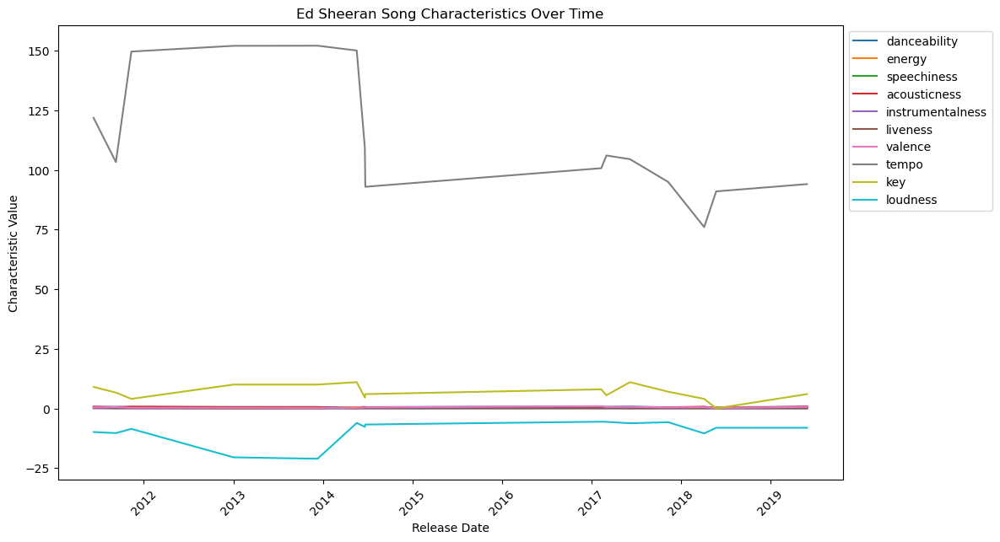

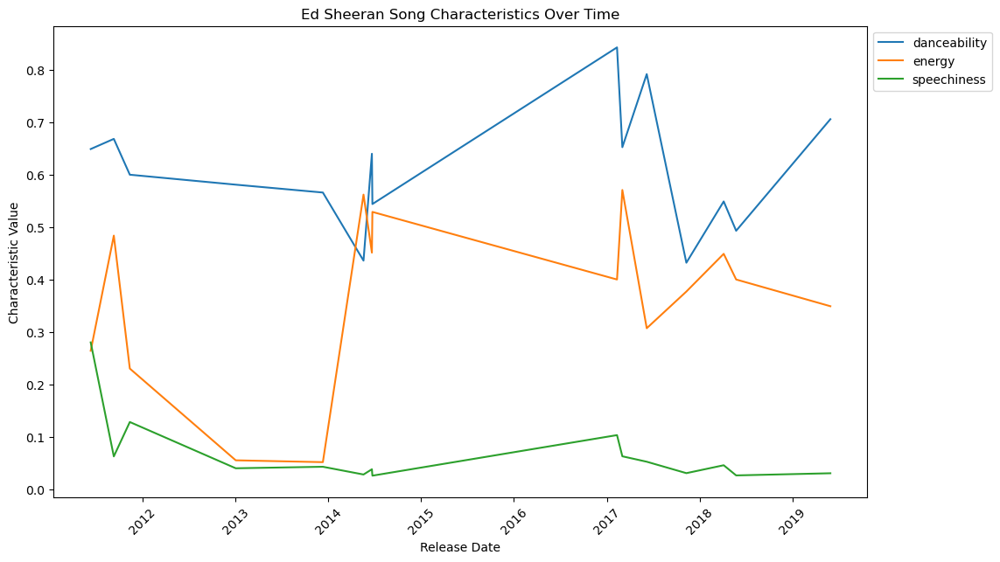

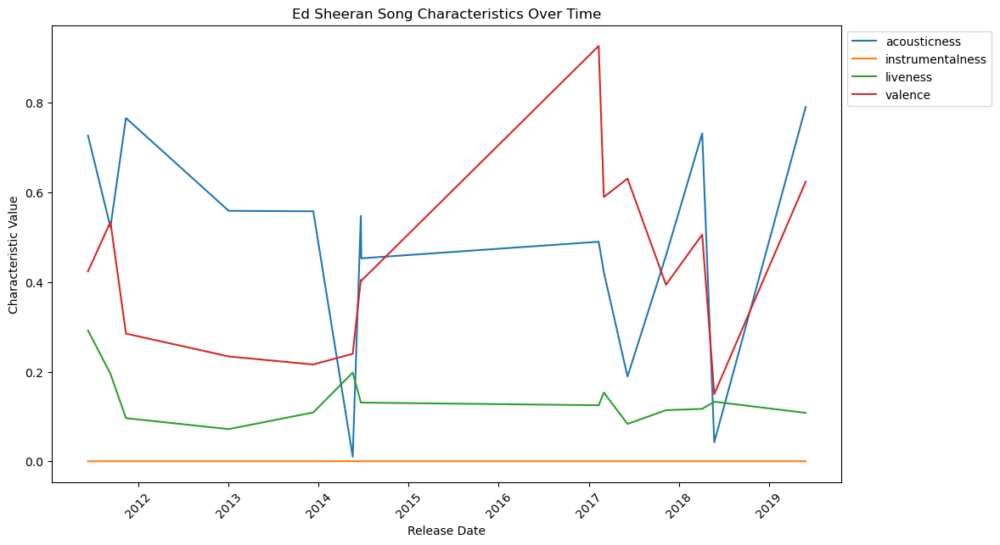

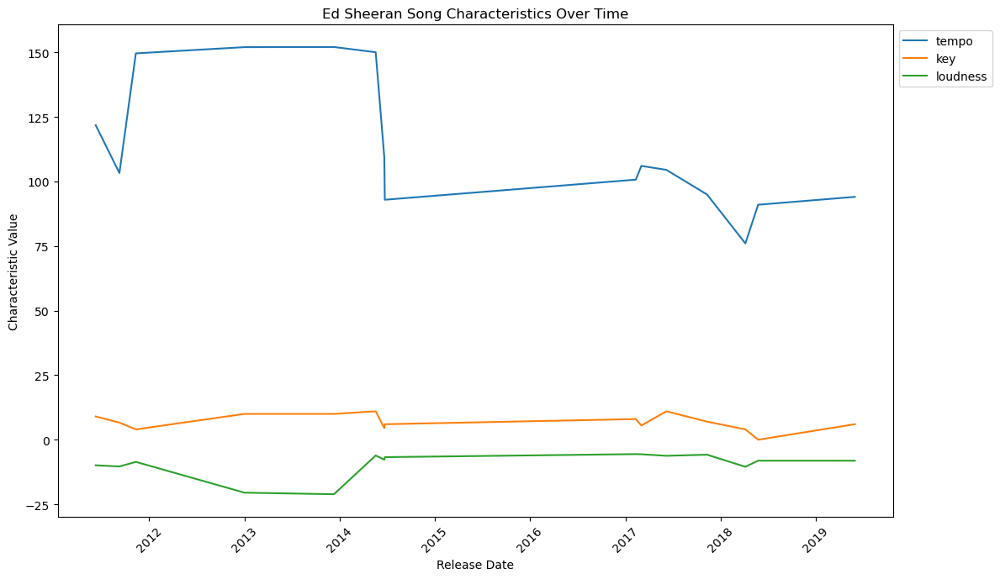

Average danceability: 0.6101242424242425
Average energy: 0.36527404040404043
Average speechiness: 0.06625641414141414
Average acousticness: 0.48460666666666674
Average instrumentalness: 2.0326424242424236e-05
Average liveness: 0.1372319191919192
Average valence: 0.4375181818181818
Average tempo: 113.24173232323233
Average key: 6.842424242424243
Average loudness: -9.398309595959596


In [52]:
ed_sheeran_songs = df3[df3['artists'] == 'Ed Sheeran']
grouped_data = ed_sheeran_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ed Sheeran Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ed Sheeran Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ed Sheeran Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ed Sheeran Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")


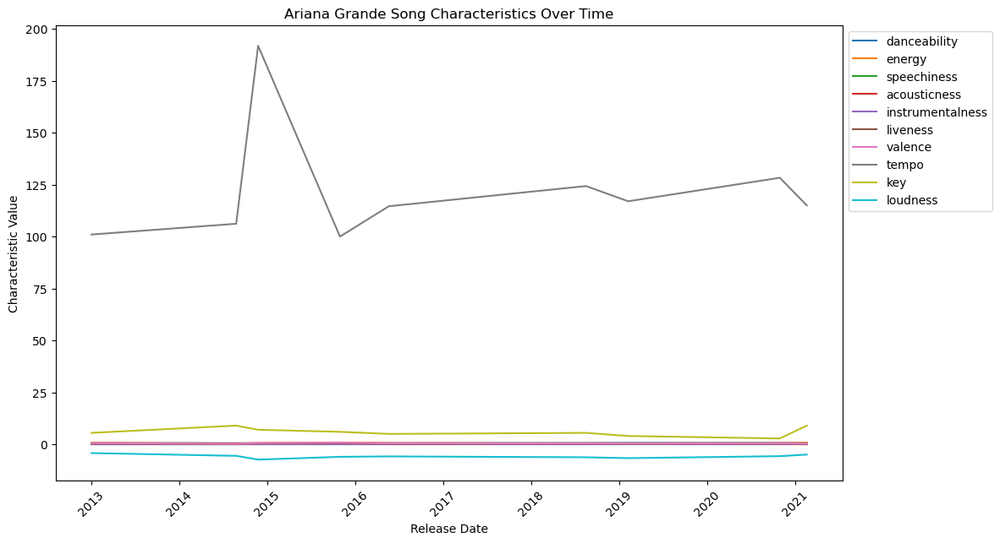

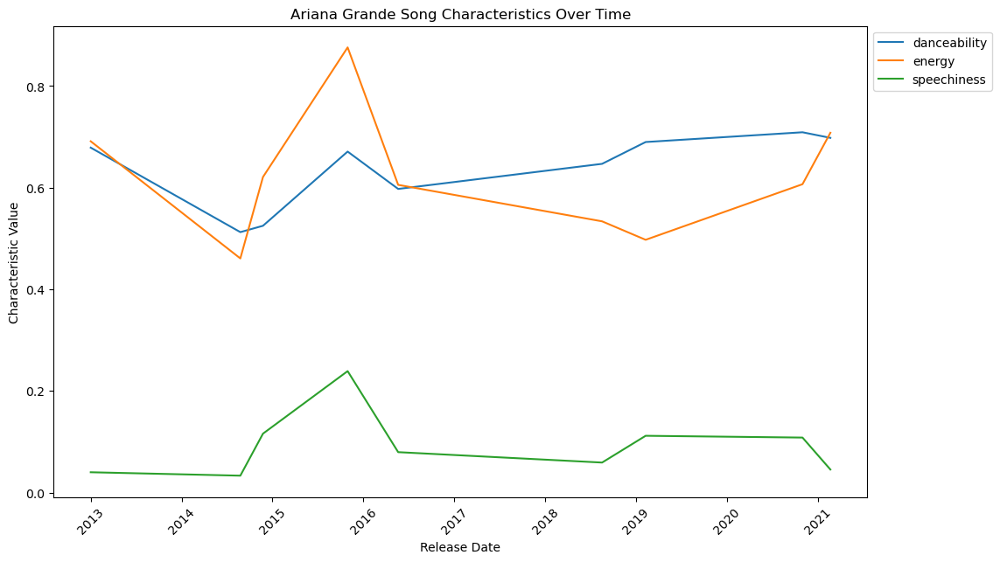

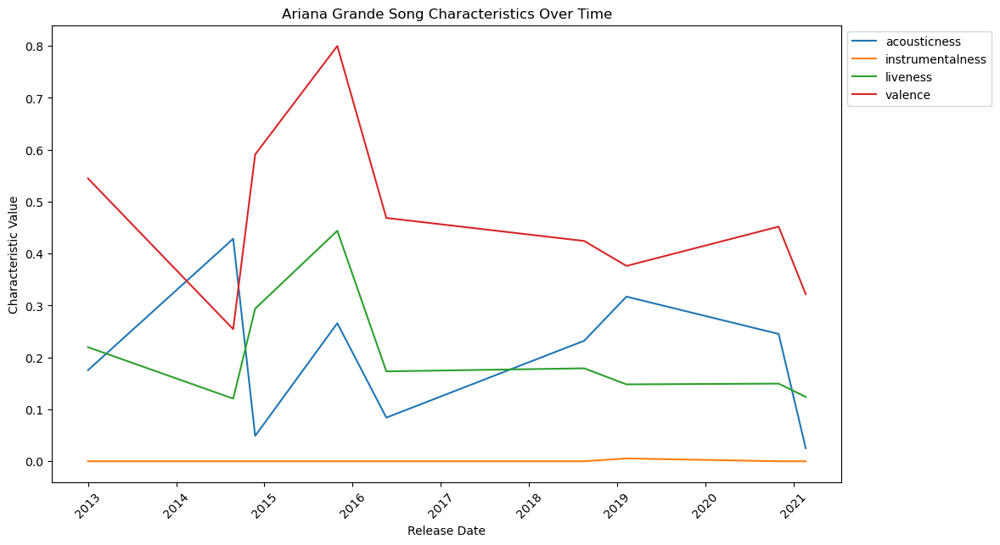

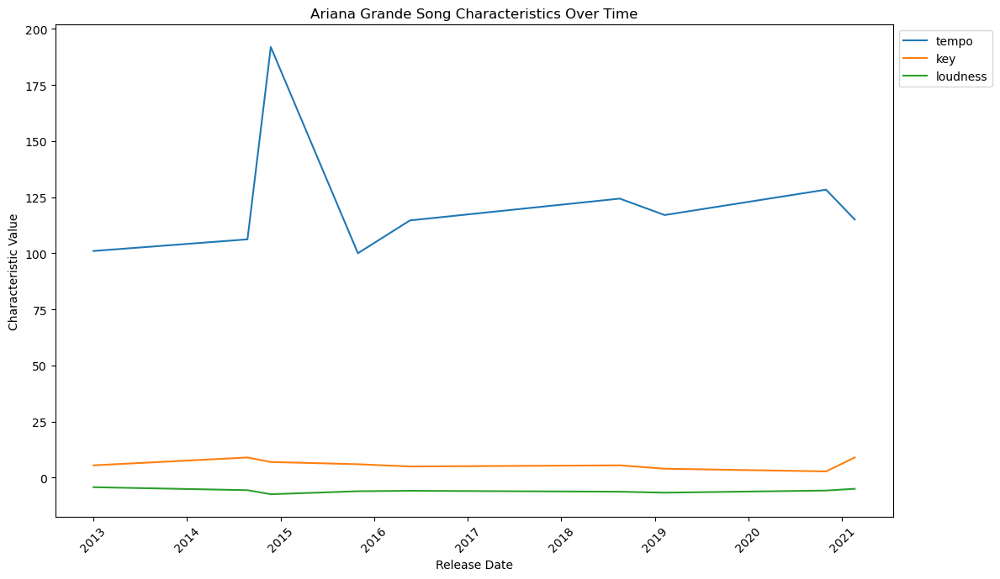

Average danceability: 0.6364916666666667
Average energy: 0.6222722222222222
Average speechiness: 0.09249222222222221
Average acousticness: 0.20252305555555555
Average instrumentalness: 0.0006108144166666666
Average liveness: 0.2058311111111111
Average valence: 0.4704083333333333
Average tempo: 122.05839166666667
Average key: 5.977777777777778
Average loudness: -5.845752777777777


In [53]:
ariana_grande_songs = df3[df3['artists'] == 'Ariana Grande']
grouped_data = ariana_grande_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ariana Grande Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ariana Grande Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ariana Grande Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Ariana Grande Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")

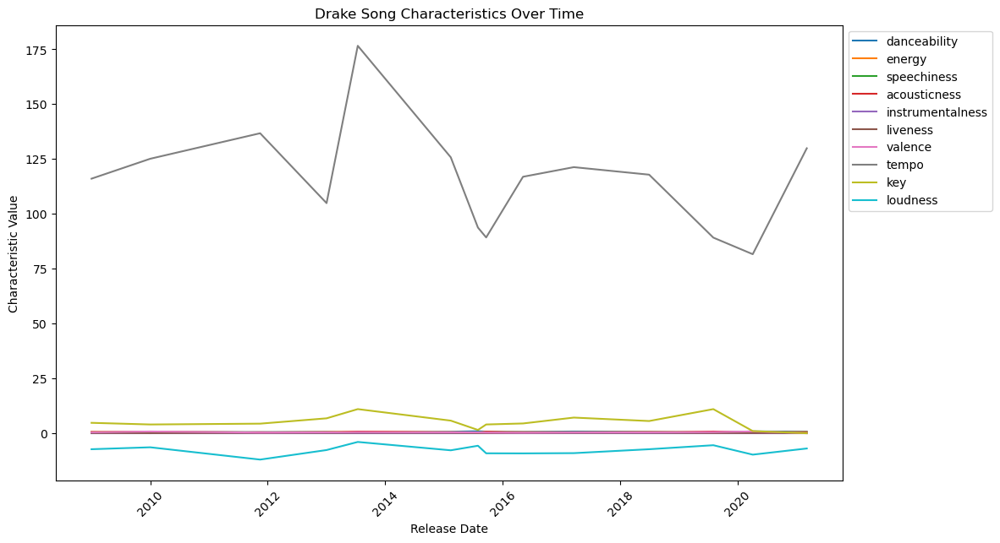

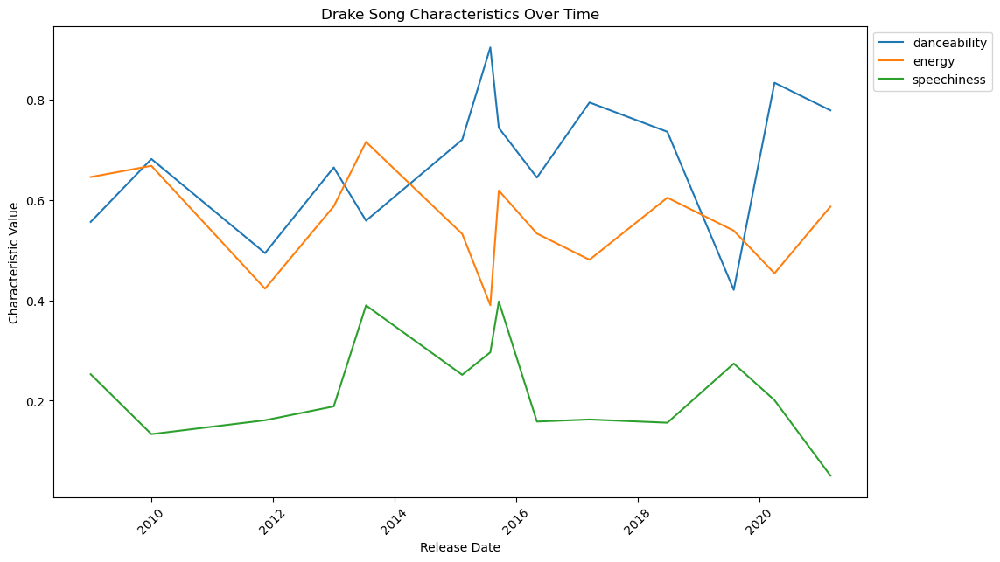

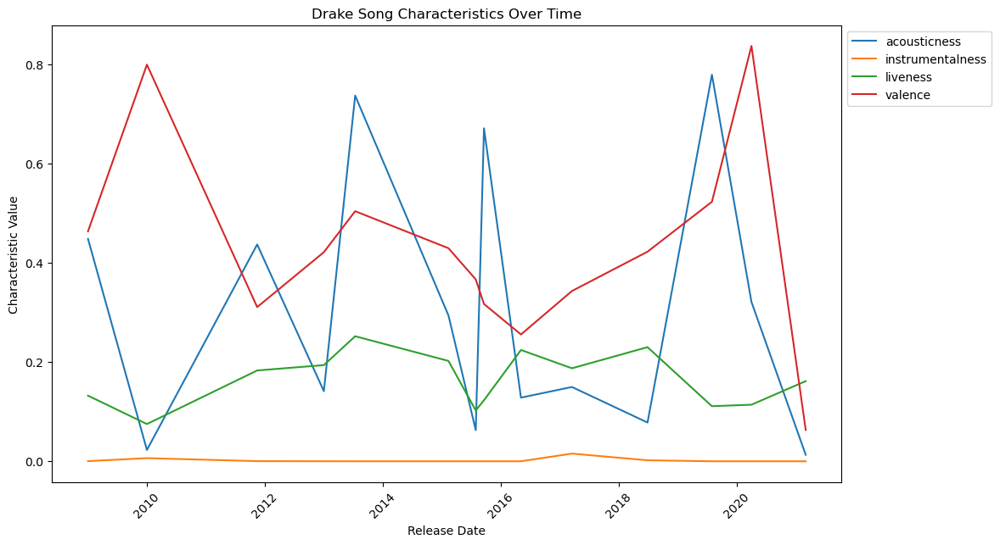

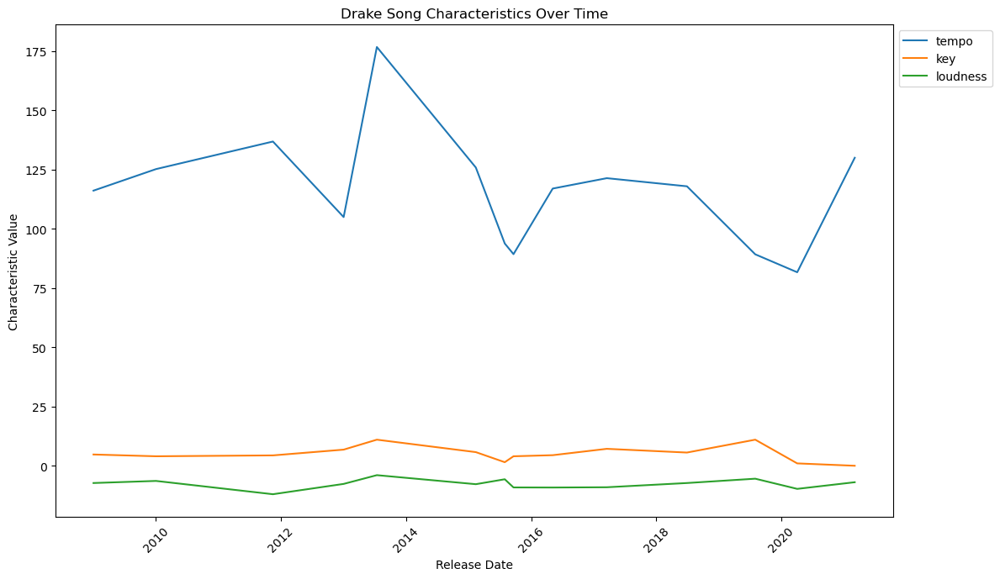

Average danceability: 0.6811075156985872
Average energy: 0.5558854461015175
Average speechiness: 0.21959447475143906
Average acousticness: 0.305928280873888
Average instrumentalness: 0.0017430243502093144
Average liveness: 0.16371287545787547
Average valence: 0.43257849947671373
Average tempo: 116.07188688513868
Average key: 5.096487441130298
Average loudness: -7.684185171376242


In [54]:
drake_songs = df3[df3['artists'] == 'Drake']
grouped_data = drake_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Drake Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Drake Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Drake Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Drake Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
 
for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")

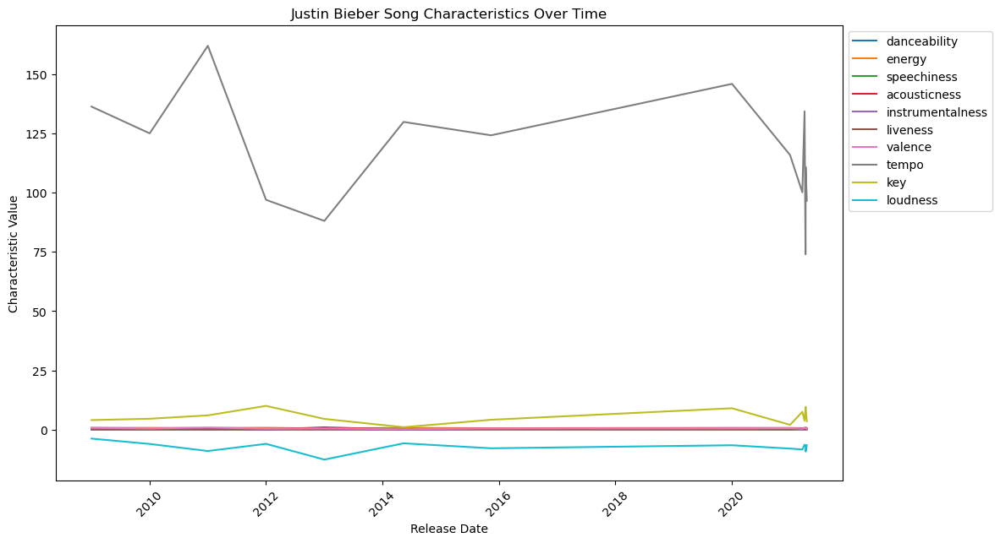

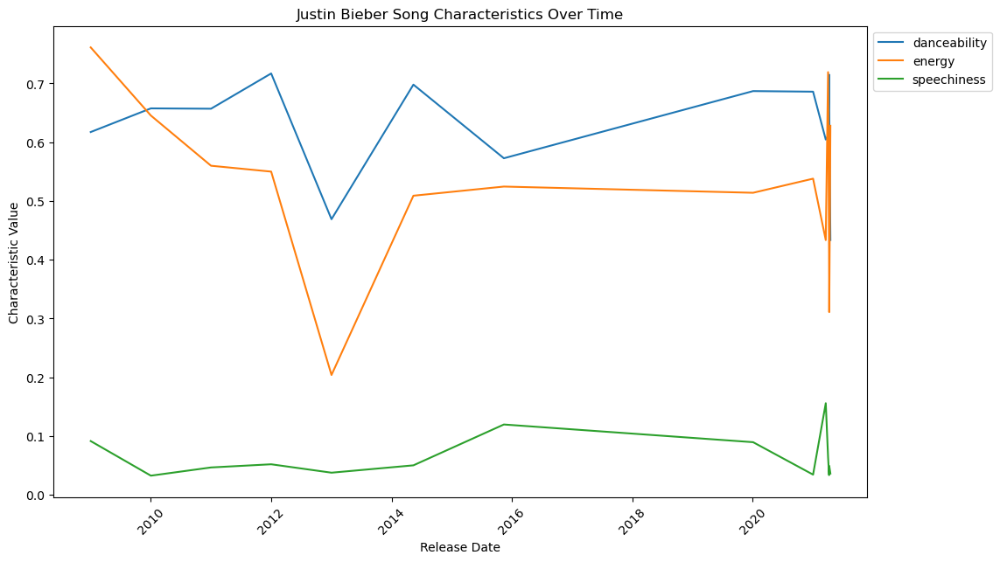

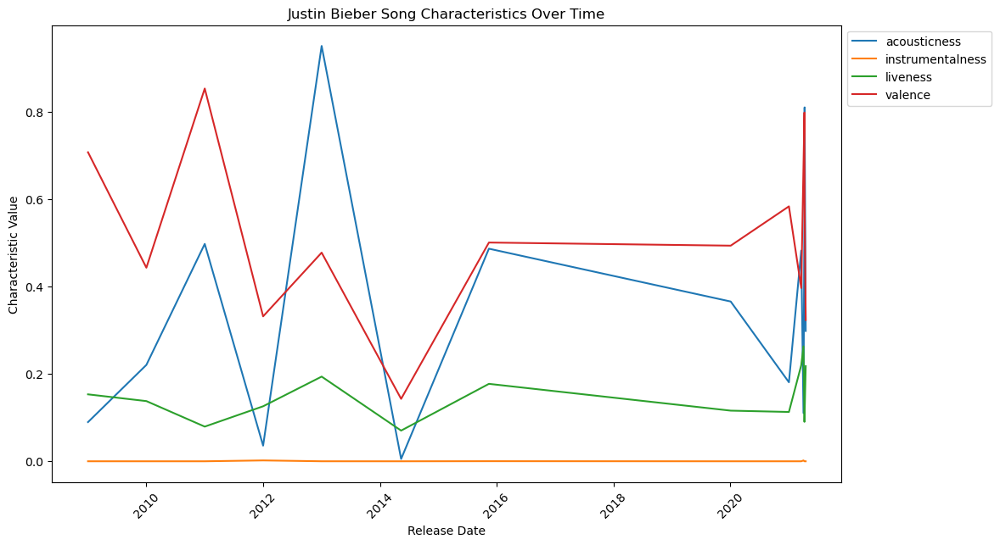

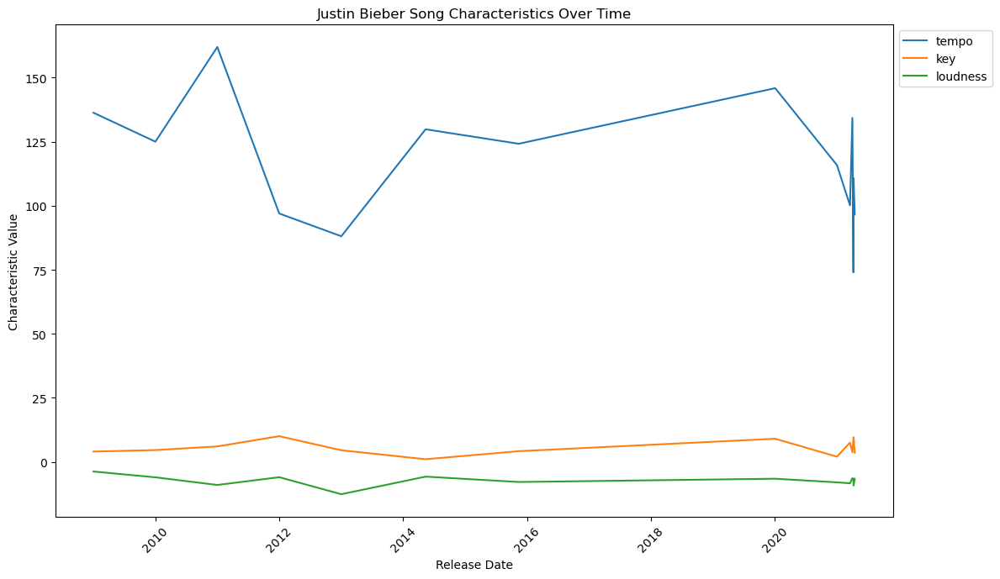

Average danceability: 0.6278299319727891
Average energy: 0.5220773809523809
Average speechiness: 0.06391787414965985
Average acousticness: 0.36654545068027217
Average instrumentalness: 0.0002953721088435374
Average liveness: 0.14748212585034012
Average valence: 0.5232750000000002
Average tempo: 117.15049302721084
Average key: 5.61173469387755
Average loudness: -7.377285204081631


In [55]:
justin_bieber_songs = df3[df3['artists'] == 'Justin Bieber']
grouped_data = justin_bieber_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Justin Bieber Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Justin Bieber Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Justin Bieber Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Justin Bieber Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
 
for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")

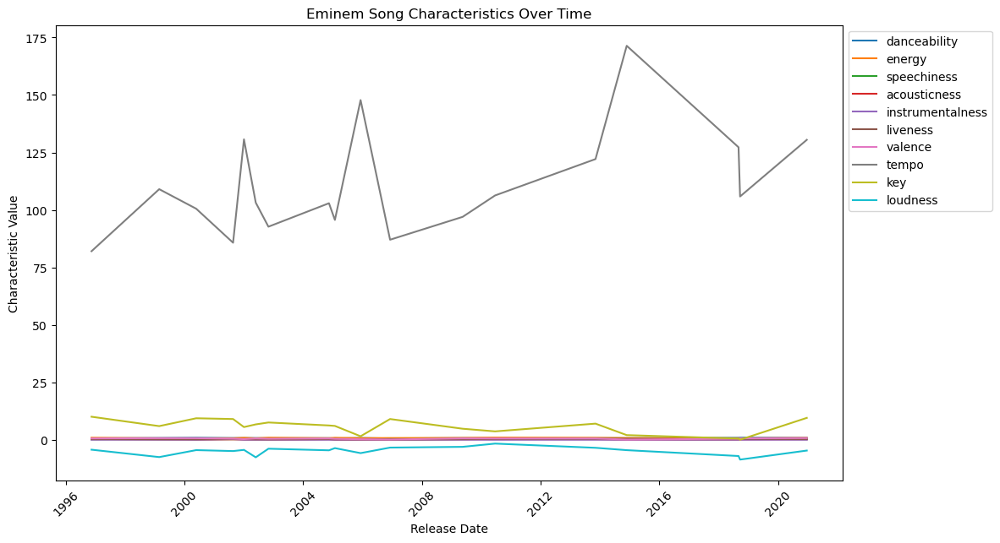

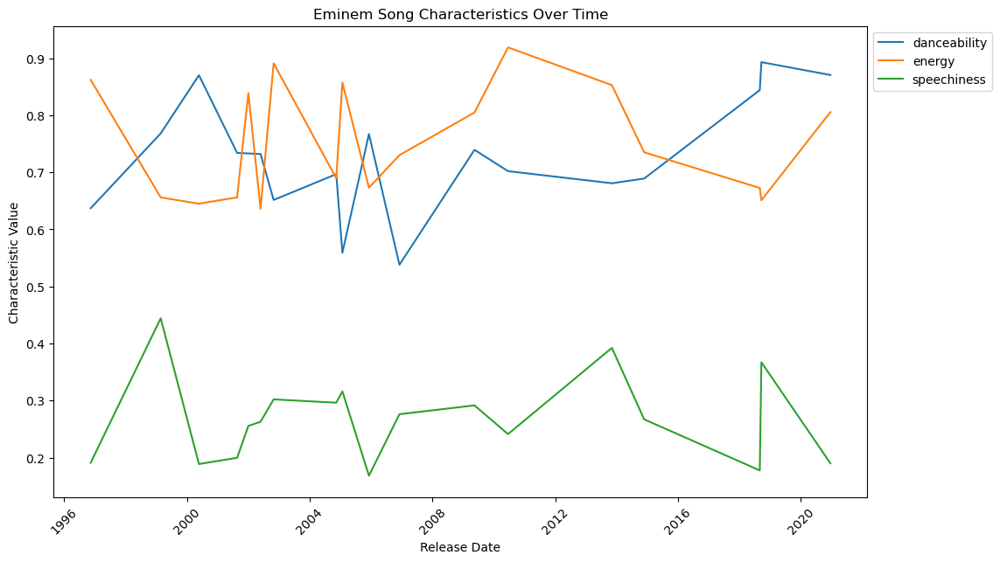

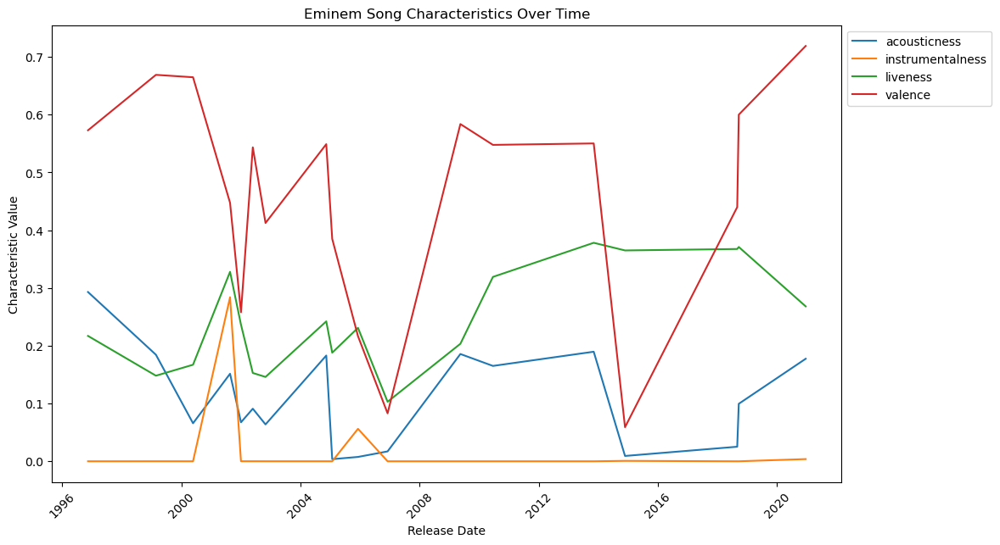

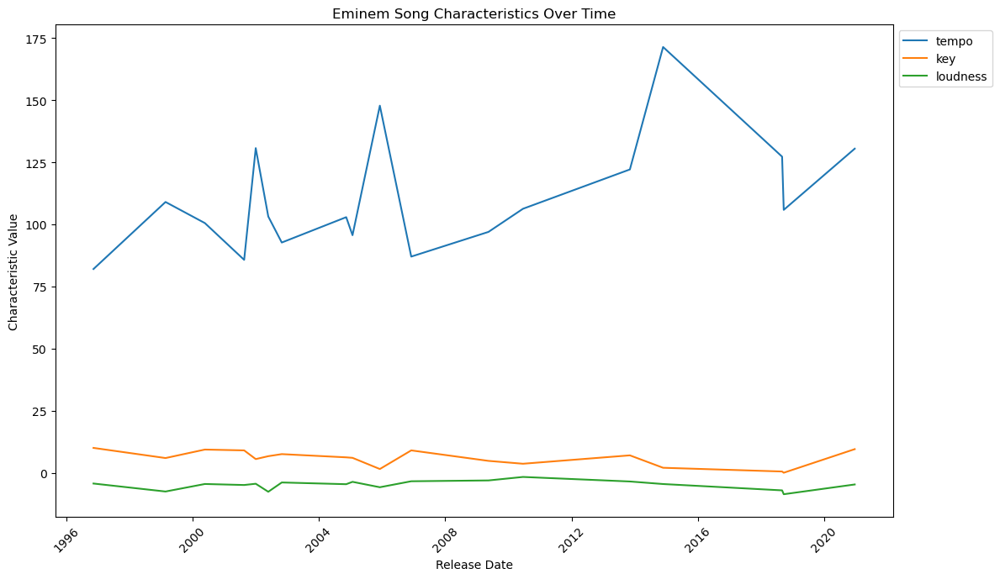

Average danceability: 0.7280574074074074
Average energy: 0.7541617283950618
Average speechiness: 0.26814000000000004
Average acousticness: 0.11001537037037036
Average instrumentalness: 0.01916978172839506
Average liveness: 0.24624324074074078
Average valence: 0.4612006172839506
Average tempo: 110.97063842592593
Average key: 5.778858024691358
Average loudness: -4.900637191358026


In [56]:
eminem_songs = df3[df3['artists'] == 'Eminem']
grouped_data = eminem_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Eminem Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Eminem Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Eminem Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Eminem Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
 
for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")

In [57]:
ytb_data = pd.read_csv("/Users/_fangkhai/Documents/Academic/Computer Science Semester 7/Data Science Toolbox/Materials/Assignment Dataset/Dataset/Spotify_Youtube.csv")

In [58]:
ytb_data

,Unnamed: 0,Artist,Url_spotify,Track,Album,Album_type,Uri,Danceability,Energy,Key,...,Url_youtube,Title,Channel,Views,Likes,Comments,Description,Licensed,official_video,Stream
0,0,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,Feel Good Inc.,Demon Days,album,spotify:track:0d28khcov6AiegSCpG5TuT,0.818,0.705,6.0,...,https://www.youtube.com/watch?v=HyHNuVaZJ-k,Gorillaz - Feel Good Inc. (Official Video),Gorillaz,693555221.0,6220896.0,169907.0,Official HD Video for Gorillaz' fantastic trac...,True,True,1.040235e+09
1,1,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,Rhinestone Eyes,Plastic Beach,album,spotify:track:1foMv2HQwfQ2vntFf9HFeG,0.676,0.703,8.0,...,https://www.youtube.com/watch?v=yYDmaexVHic,Gorillaz - Rhinestone Eyes [Storyboard Film] (...,Gorillaz,72011645.0,1079128.0,31003.0,The official video for Gorillaz - Rhinestone E...,True,True,3.100837e+08
2,2,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,New Gold (feat. Tame Impala and Bootie Brown),New Gold (feat. Tame Impala and Bootie Brown),single,spotify:track:64dLd6rVqDLtkXFYrEUHIU,0.695,0.923,1.0,...,https://www.youtube.com/watch?v=qJa-VFwPpYA,Gorillaz - New Gold ft. Tame Impala & Bootie B...,Gorillaz,8435055.0,282142.0,7399.0,Gorillaz - New Gold ft. Tame Impala & Bootie B...,True,True,6.306347e+07
3,3,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,On Melancholy Hill,Plastic Beach,album,spotify:track:0q6LuUqGLUiCPP1cbdwFs3,0.689,0.739,2.0,...,https://www.youtube.com/watch?v=04mfKJWDSzI,Gorillaz - On Melancholy Hill (Official Video),Gorillaz,211754952.0,1788577.0,55229.0,Follow Gorillaz online:\nhttp://gorillaz.com \...,True,True,4.346636e+08
4,4,Gorillaz,https://open.spotify.com/artist/3AA28KZvwAUcZu...,Clint Eastwood,Gorillaz,album,spotify:track:7yMiX7n9SBvadzox8T5jzT,0.663,0.694,10.0,...,https://www.youtube.com/watch?v=1V_xRb0x9aw,Gorillaz - Clint Eastwood (Official Video),Gorillaz,618480958.0,6197318.0,155930.0,The official music video for Gorillaz - Clint ...,True,True,6.172597e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20713,20713,SICK LEGEND,https://open.spotify.com/artist/3EYY5FwDkHEYLw...,JUST DANCE HARDSTYLE,JUST DANCE HARDSTYLE,single,spotify:track:0RtcKQGyI4hr8FgFH1TuYG,0.582,0.926,5.0,...,https://www.youtube.com/watch?v=5SHmKFKlNqI,JUST DANCE HARDSTYLE,SICK LEGEND - Topic,71678.0,1113.0,0.0,Provided to YouTube by Routenote\n\nJUST DANCE...,True,True,9.227144e+06
20714,20714,SICK LEGEND,https://open.spotify.com/artist/3EYY5FwDkHEYLw...,SET FIRE TO THE RAIN HARDSTYLE,SET FIRE TO THE RAIN HARDSTYLE,single,spotify:track:3rHvPA8lUnPBkaLyPOc0VV,0.531,0.936,4.0,...,https://www.youtube.com/watch?v=ocTH6KxllDQ,SET FIRE TO THE RAIN HARDSTYLE,SICK LEGEND - Topic,164741.0,2019.0,0.0,Provided to YouTube by Routenote\n\nSET FIRE T...,True,True,1.089818e+07
20715,20715,SICK LEGEND,https://open.spotify.com/artist/3EYY5FwDkHEYLw...,OUTSIDE HARDSTYLE SPED UP,OUTSIDE HARDSTYLE SPED UP,single,spotify:track:4jk00YxPtPbhvHJE9N4ddv,0.443,0.830,4.0,...,https://www.youtube.com/watch?v=5wFhE-HY0hg,OUTSIDE HARDSTYLE SPED UP,SICK LEGEND - Topic,35646.0,329.0,0.0,Provided to YouTube by Routenote\n\nOUTSIDE HA...,True,True,6.226110e+06
20716,20716,SICK LEGEND,https://open.spotify.com/artist/3EYY5FwDkHEYLw...,ONLY GIRL HARDSTYLE,ONLY GIRL HARDSTYLE,single,spotify:track:5EyErbpsugWliX006eTDex,0.417,0.767,9.0,...,https://www.youtube.com/watch?v=VMFLbFRNCn0,ONLY GIRL HARDSTYLE,SICK LEGEND - Topic,6533.0,88.0,0.0,Provided to YouTube by Routenote\n\nONLY GIRL ...,True,True,6.873961e+06


In [59]:
ytb_data.columns

Index(['Unnamed: 0', 'Artist', 'Url_spotify', 'Track', 'Album', 'Album_type',
       'Uri', 'Danceability', 'Energy', 'Key', 'Loudness', 'Speechiness',
       'Acousticness', 'Instrumentalness', 'Liveness', 'Valence', 'Tempo',
       'Duration_ms', 'Url_youtube', 'Title', 'Channel', 'Views', 'Likes',
       'Comments', 'Description', 'Licensed', 'official_video', 'Stream'],
      dtype='object')

In [60]:
columns_to_drop = ["Unnamed: 0", "Url_spotify", "Album_type", "Uri", "Danceability", "Energy", "Key", "Loudness", "Album", "Title", "Channel", "Likes", "Comments", "Description", "Licensed", "official_video", "Stream", "Speechiness", "Acousticness", "Instrumentalness", "Liveness", "Valence", "Tempo", "Url_youtube"]

In [61]:
ytb_data = ytb_data.drop(columns = columns_to_drop)

In [62]:
ytb_data

,Artist,Track,Duration_ms,Views
0,Gorillaz,Feel Good Inc.,222640.0,693555221.0
1,Gorillaz,Rhinestone Eyes,200173.0,72011645.0
2,Gorillaz,New Gold (feat. Tame Impala and Bootie Brown),215150.0,8435055.0
3,Gorillaz,On Melancholy Hill,233867.0,211754952.0
4,Gorillaz,Clint Eastwood,340920.0,618480958.0
...,...,...,...,...
20713,SICK LEGEND,JUST DANCE HARDSTYLE,94667.0,71678.0
20714,SICK LEGEND,SET FIRE TO THE RAIN HARDSTYLE,150857.0,164741.0
20715,SICK LEGEND,OUTSIDE HARDSTYLE SPED UP,136842.0,35646.0
20716,SICK LEGEND,ONLY GIRL HARDSTYLE,108387.0,6533.0


In [63]:
ytb_data.isnull().sum()

Artist           0
Track            0
Duration_ms      2
Views          470
dtype: int64

In [64]:
ytb_data["Views"].fillna(ytb_data["Views"].mean, inplace = True)
ytb_data.dropna()

,Artist,Track,Duration_ms,Views
0,Gorillaz,Feel Good Inc.,222640.0,693555221.0
1,Gorillaz,Rhinestone Eyes,200173.0,72011645.0
2,Gorillaz,New Gold (feat. Tame Impala and Bootie Brown),215150.0,8435055.0
3,Gorillaz,On Melancholy Hill,233867.0,211754952.0
4,Gorillaz,Clint Eastwood,340920.0,618480958.0
...,...,...,...,...
20713,SICK LEGEND,JUST DANCE HARDSTYLE,94667.0,71678.0
20714,SICK LEGEND,SET FIRE TO THE RAIN HARDSTYLE,150857.0,164741.0
20715,SICK LEGEND,OUTSIDE HARDSTYLE SPED UP,136842.0,35646.0
20716,SICK LEGEND,ONLY GIRL HARDSTYLE,108387.0,6533.0


In [65]:
ytb_data.isnull().sum()

Artist         0
Track          0
Duration_ms    2
Views          0
dtype: int64

In [66]:
ytb_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20718 entries, 0 to 20717
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Artist       20718 non-null  object 
 1   Track        20718 non-null  object 
 2   Duration_ms  20716 non-null  float64
 3   Views        20718 non-null  object 
dtypes: float64(1), object(3)
memory usage: 647.6+ KB


In [67]:
ytb_data.describe()

,Duration_ms
count,2.071600e+04
mean,2.247176e+05
std,1.247905e+05
min,3.098500e+04
25%,1.800095e+05
50%,2.132845e+05
75%,2.524430e+05
max,4.676058e+06


In [68]:
ytb_data["Duration_ms"] = ytb_data["Duration_ms"] / 60000
ytb_data.rename(columns = {"Duration_ms" : "Duration"}, inplace = True)

In [69]:
ytb_data["Views"] = pd.to_numeric(ytb_data["Views"], errors = "coerce")

In [70]:
timeFrames = []

n = 0.25
while n <= 78:
    timeFrames.append(n)
    n += 0.25

def calculate_views_within_timeframe(ytb_data, timeframe):
    return ytb_data[(ytb_data["Duration"] <= timeframe) & (ytb_data["Duration"] >= timeframe - 0.25)]["Views"].mean()

In [71]:
calculate_views = [calculate_views_within_timeframe(ytb_data, timeframe) for timeframe in timeFrames]
results_df = pd.DataFrame({'Timeframe (minutes)': timeFrames, 'Views': calculate_views})

In [72]:
fig = px.scatter(
    results_df,
    x = 'Timeframe (minutes)',
    y = 'Views',
    title = 'Views Based On The Duration',
    labels = {'Timeframe (minutes)': 'Duration (minutes)', 'Views': 'Average Views'},
    color_discrete_sequence = ['blue'], 
    hover_name = 'Timeframe (minutes)',
)

fig.add_trace(
    px.scatter(
        results_df,
        x = 'Timeframe (minutes)',
        y = 'Views',
        trendline = 'ols',
        custom_data = ['Timeframe (minutes)'],
        color_discrete_sequence = ['red'], 
    ).data[1]
)

fig.update_layout(
    xaxis_title = 'Duration (minutes)',
    yaxis_title = 'Average Views',
    legend_title = 'Legend',
    hovermode = 'closest',
)

fig.show()

In [73]:
df_top_10_artists = ytb_data.drop_duplicates(subset='Artist').nlargest(10, 'Views')

fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'polar'}]])
fig.add_trace(go.Scatterpolar(r=df_top_10_artists['Views'], theta=df_top_10_artists['Artist'], fill='toself'), row=1, col=1)
fig.update_traces(fillcolor = 'lightblue')

fig.update_layout(height=600, width=800, title_text="Top 10 Artists vs Followers")
fig.show()

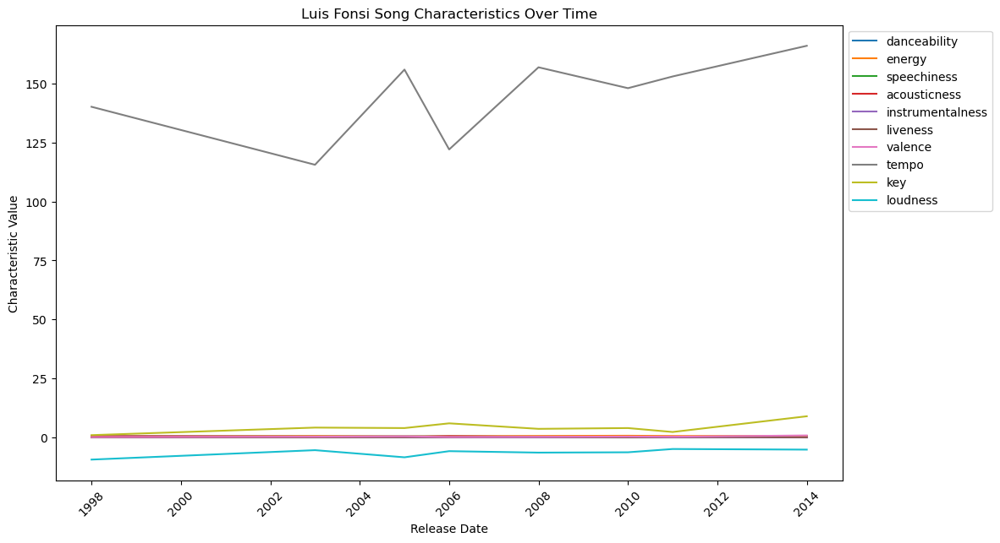

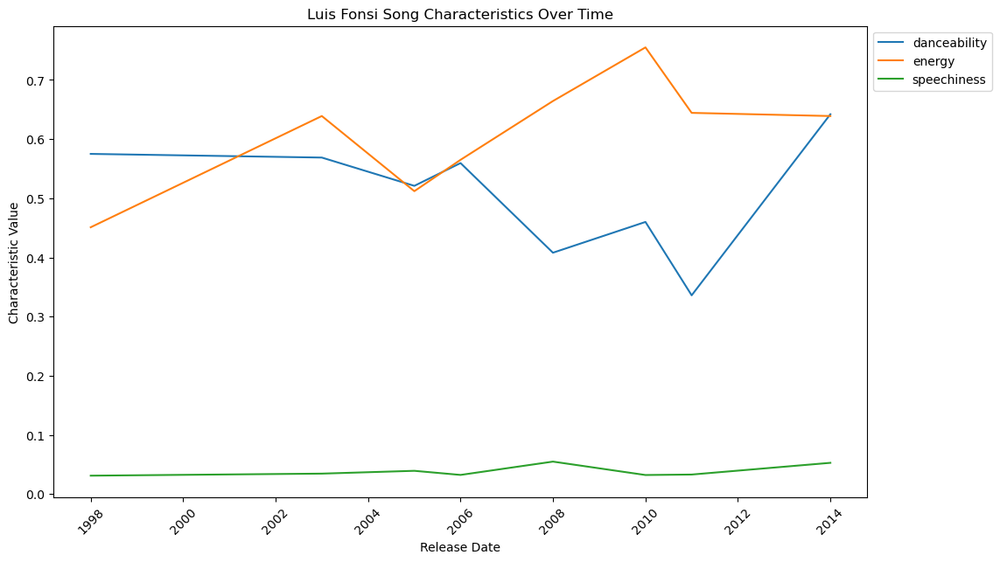

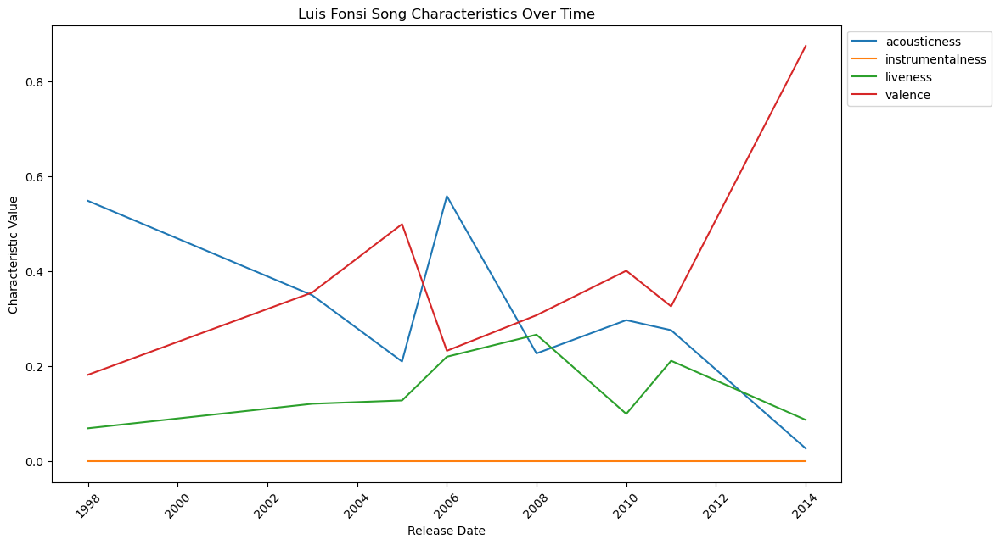

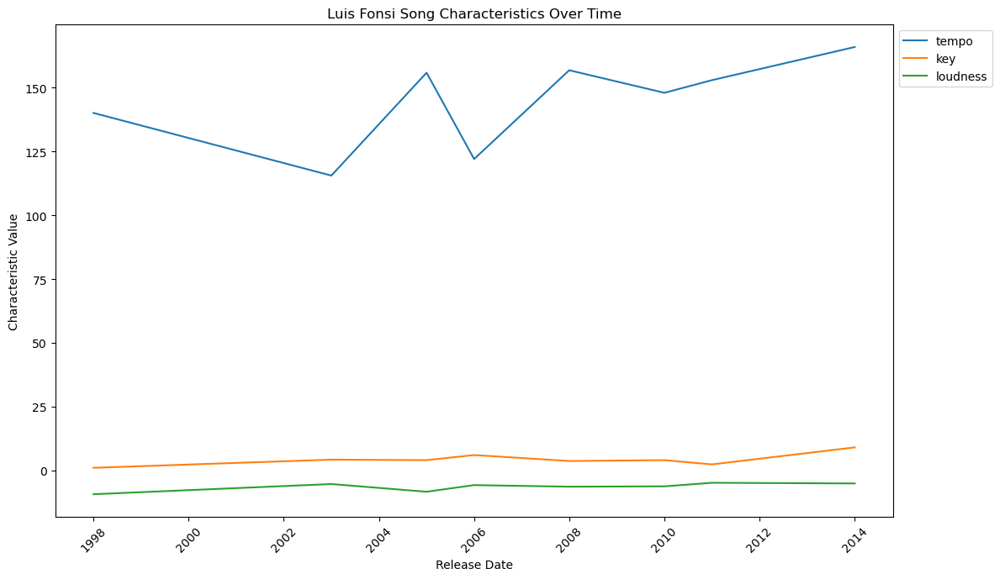

Average danceability: 0.5087875
Average energy: 0.6087083333333333
Average speechiness: 0.038872083333333335
Average acousticness: 0.31153333333333333
Average instrumentalness: 0.0
Average liveness: 0.15039166666666667
Average valence: 0.39712916666666664
Average tempo: 144.6866875
Average key: 4.275
Average loudness: -6.447245833333334


In [74]:
luis_songs = df3[df3['artists'] == 'Luis Fonsi']
grouped_data = luis_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Luis Fonsi Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Luis Fonsi Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Luis Fonsi Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Luis Fonsi Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")


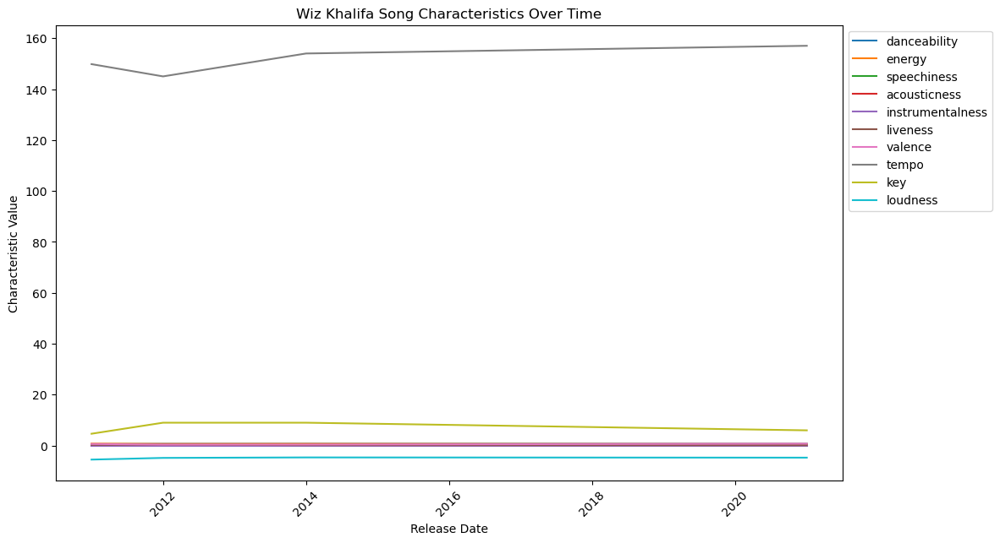

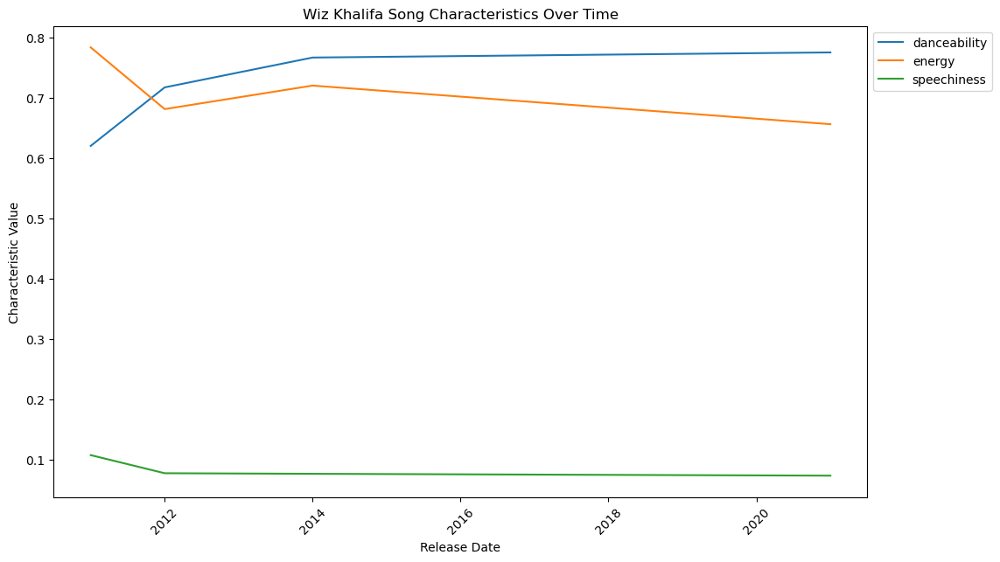

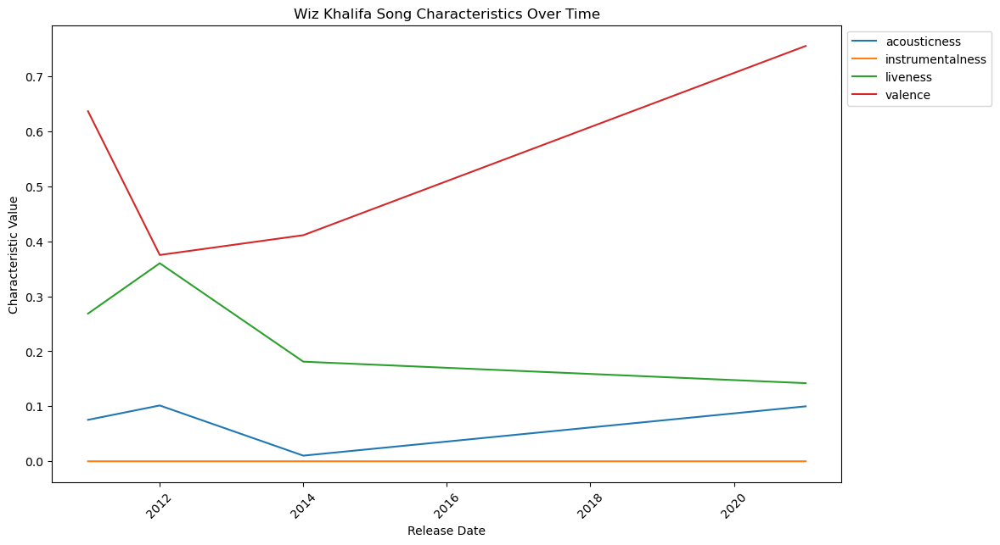

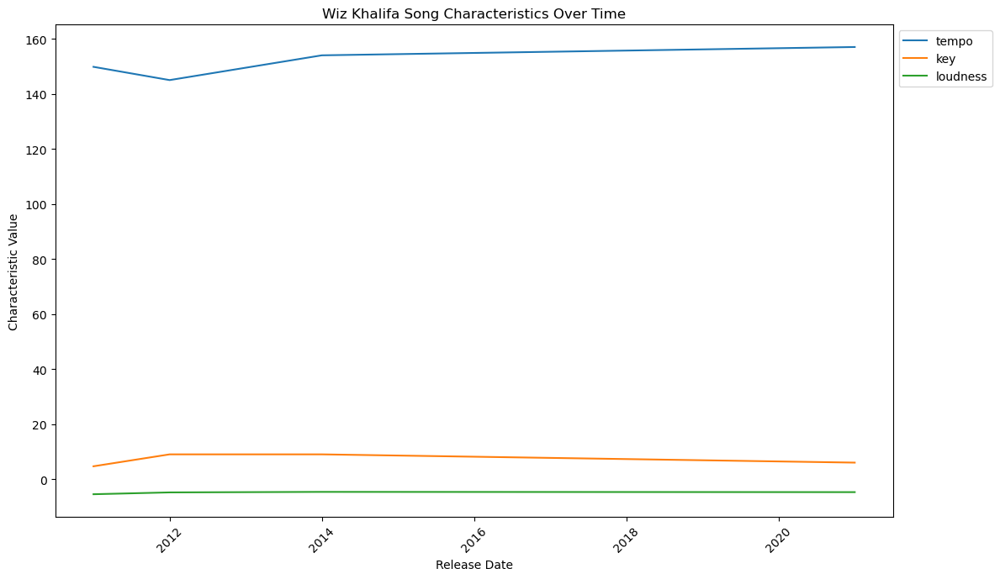

Average danceability: 0.7196250000000001
Average energy: 0.7100833333333333
Average speechiness: 0.08350416666666666
Average acousticness: 0.07173208333333334
Average instrumentalness: 4.144999999999999e-06
Average liveness: 0.2378916666666667
Average valence: 0.5443333333333333
Average tempo: 151.45041666666668
Average key: 7.166666666666667
Average loudness: -4.916416666666667


In [98]:
wiz_khalifa_songs = df3[df3['artists'] == 'Wiz Khalifa']
grouped_data = wiz_khalifa_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Wiz Khalifa Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Wiz Khalifa Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Wiz Khalifa Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Wiz Khalifa Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")

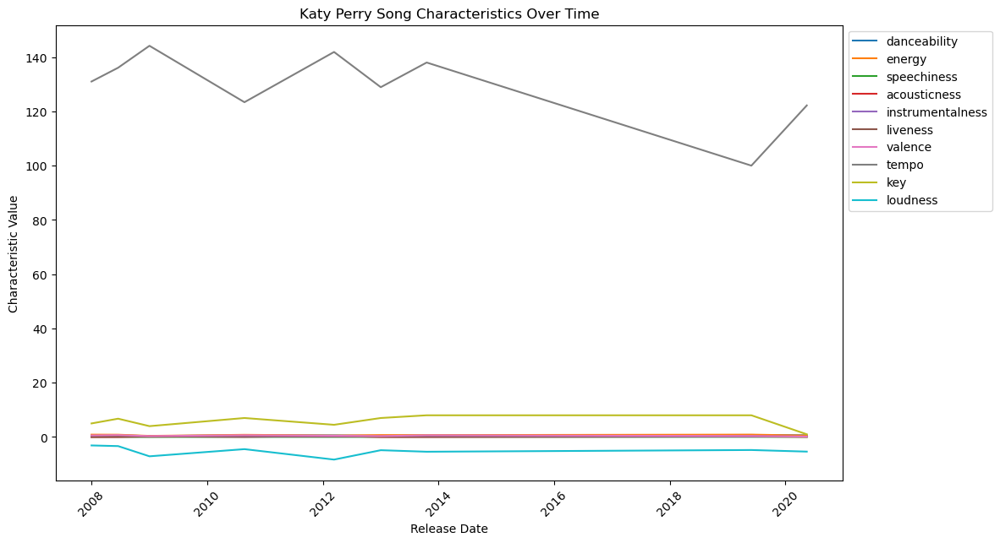

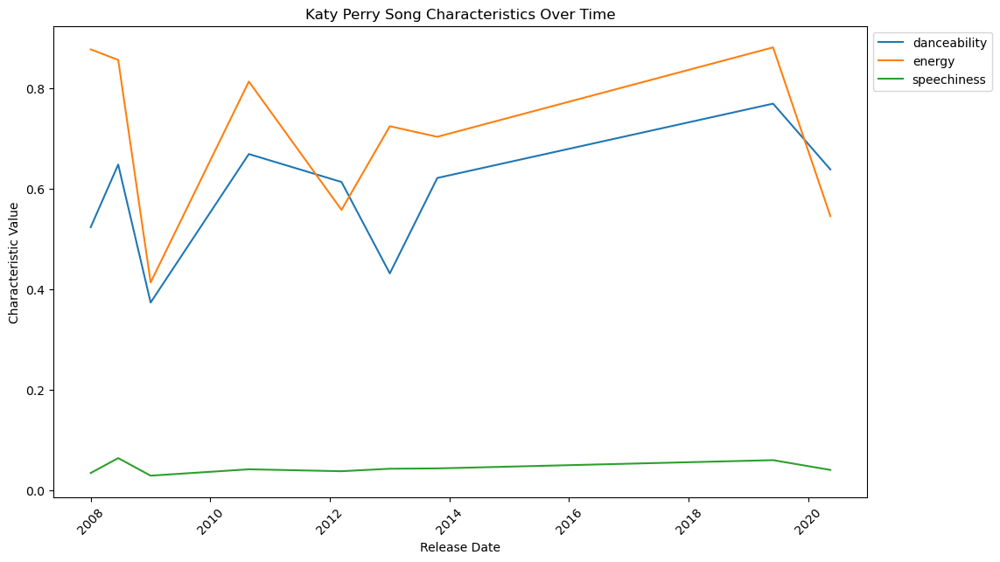

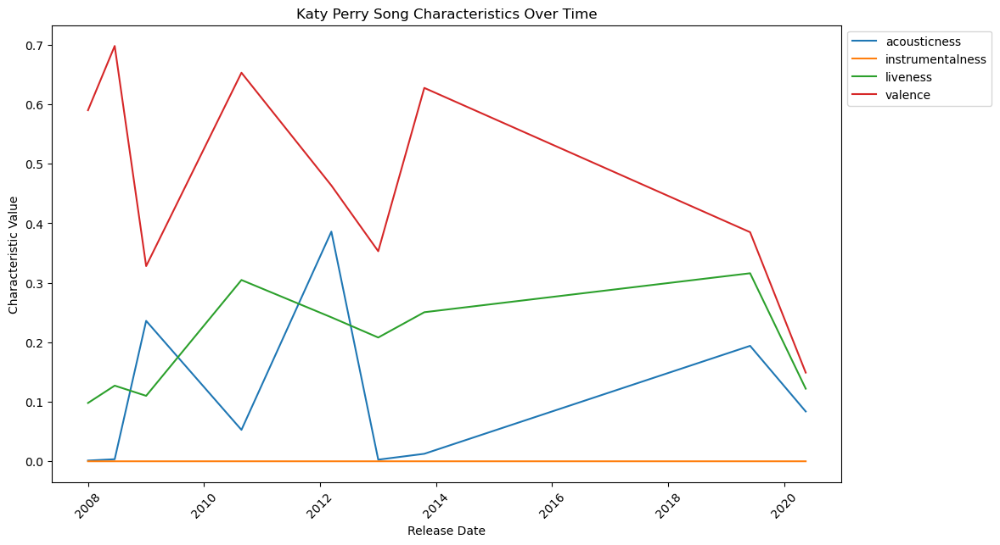

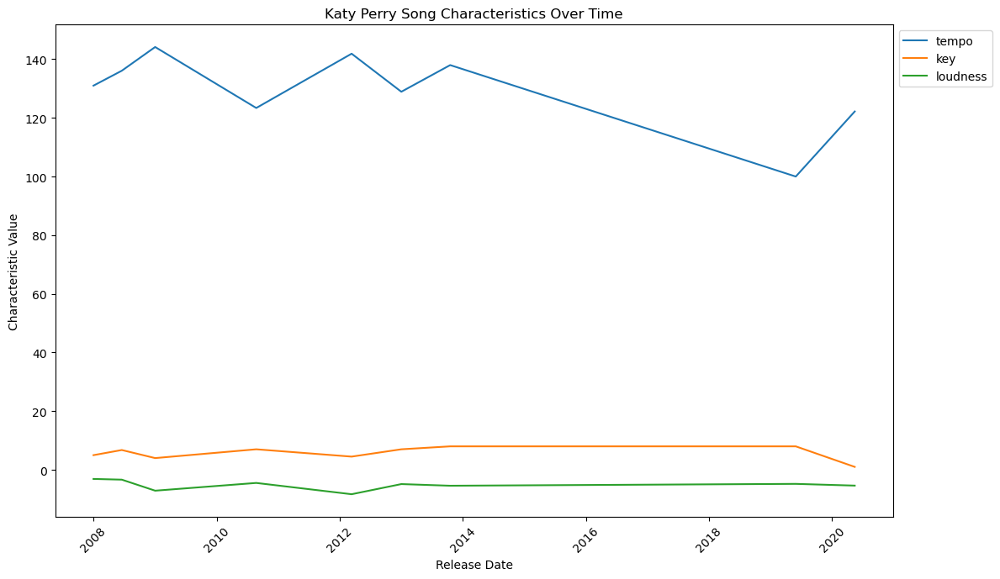

Average danceability: 0.5881574074074074
Average energy: 0.7087222222222223
Average speechiness: 0.04400555555555555
Average acousticness: 0.10804958796296296
Average instrumentalness: 1.7148148148148148e-06
Average liveness: 0.19758240740740737
Average valence: 0.47188888888888897
Average tempo: 129.50292592592595
Average key: 5.694444444444445
Average loudness: -5.202851851851851


In [76]:
katy_perry_songs = df3[df3['artists'] == 'Katy Perry']
grouped_data = katy_perry_songs.groupby('release_date').mean()

plt.figure(figsize=(12, 7))

char = ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'key', 'loudness']

for characteristic in char:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Katy Perry Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['danceability', 'energy', 'speechiness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Katy Perry Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['acousticness', 'instrumentalness', 'liveness', 'valence']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Katy Perry Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)


plt.figure(figsize=(12, 7))
characteristics = ['tempo', 'key', 'loudness']

for characteristic in characteristics:
    plt.plot(grouped_data.index, grouped_data[characteristic], label=characteristic)

plt.xlabel('Release Date')
plt.ylabel('Characteristic Value')
plt.title('Katy Perry Song Characteristics Over Time')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

for characteristic in char:
    avg_value = grouped_data[characteristic].mean()
    print(f"Average {characteristic}: {avg_value}")


In [77]:
df3['release_date'] = pd.to_datetime(df3['release_date'], format='%Y-%m-%d')
df3

,name,popularity,duration,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,followers,year,year_group,cluster
0,Carve,6,2.115050,0,Uli,1922-02-22,0.645,0.44500,0,-13.338,0.4510,0.674,0.744000,0.1510,0.127,104.851,91,1922,1920-1924,5
1,Lazy Boi,0,2.622217,0,Uli,1922-02-22,0.298,0.46000,1,-18.645,0.4530,0.521,0.856000,0.4360,0.402,87.921,91,1922,1920-1924,5
2,Sketch,0,1.450667,0,Uli,1922-02-22,0.634,0.00399,5,-29.973,0.0377,0.926,0.919000,0.1050,0.396,79.895,91,1922,1920-1924,5
3,L'enfer,0,0.666667,0,Uli,1922-02-22,0.657,0.32500,10,-14.319,0.2540,0.199,0.856000,0.0931,0.105,81.944,91,1922,1920-1924,5
4,Graphite,0,1.740000,0,Uli,1922-02-22,0.644,0.68400,7,-8.247,0.1990,0.144,0.802000,0.0847,0.138,100.031,91,1922,1920-1924,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
351773,The Cutest Puppy,67,1.375000,0,Laureen Conrad,2020-10-30,0.609,0.01720,8,-28.573,0.1180,0.996,0.973000,0.1080,0.890,68.619,23,2020,2015-2019,3
351774,同行 (新加坡電視劇《愛...沒有距離》主題曲),43,3.420633,0,Boon Hui Lu,2020-03-03,0.743,0.67900,8,-3.952,0.0323,0.269,0.000000,0.1330,0.395,126.070,36088,2020,2015-2019,0
351775,John Brown's Song,66,3.087500,0,Gregory Oberle,2020-03-20,0.562,0.03310,1,-25.551,0.1030,0.996,0.961000,0.1110,0.386,63.696,91,2020,2015-2019,3
351776,云与海,50,4.304450,0,阿YueYue,2020-09-26,0.560,0.51800,0,-7.471,0.0292,0.785,0.000000,0.0648,0.211,131.896,896,2020,2015-2019,3


In [78]:
df3['release_date'] = pd.to_datetime(df3['release_date']).dt.year
df3

,name,popularity,duration,explicit,artists,release_date,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,followers,year,year_group,cluster
0,Carve,6,2.115050,0,Uli,1922,0.645,0.44500,0,-13.338,0.4510,0.674,0.744000,0.1510,0.127,104.851,91,1922,1920-1924,5
1,Lazy Boi,0,2.622217,0,Uli,1922,0.298,0.46000,1,-18.645,0.4530,0.521,0.856000,0.4360,0.402,87.921,91,1922,1920-1924,5
2,Sketch,0,1.450667,0,Uli,1922,0.634,0.00399,5,-29.973,0.0377,0.926,0.919000,0.1050,0.396,79.895,91,1922,1920-1924,5
3,L'enfer,0,0.666667,0,Uli,1922,0.657,0.32500,10,-14.319,0.2540,0.199,0.856000,0.0931,0.105,81.944,91,1922,1920-1924,5
4,Graphite,0,1.740000,0,Uli,1922,0.644,0.68400,7,-8.247,0.1990,0.144,0.802000,0.0847,0.138,100.031,91,1922,1920-1924,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
351773,The Cutest Puppy,67,1.375000,0,Laureen Conrad,2020,0.609,0.01720,8,-28.573,0.1180,0.996,0.973000,0.1080,0.890,68.619,23,2020,2015-2019,3
351774,同行 (新加坡電視劇《愛...沒有距離》主題曲),43,3.420633,0,Boon Hui Lu,2020,0.743,0.67900,8,-3.952,0.0323,0.269,0.000000,0.1330,0.395,126.070,36088,2020,2015-2019,0
351775,John Brown's Song,66,3.087500,0,Gregory Oberle,2020,0.562,0.03310,1,-25.551,0.1030,0.996,0.961000,0.1110,0.386,63.696,91,2020,2015-2019,3
351776,云与海,50,4.304450,0,阿YueYue,2020,0.560,0.51800,0,-7.471,0.0292,0.785,0.000000,0.0648,0.211,131.896,896,2020,2015-2019,3


## Acoustic

In [79]:
predict_data = df3[['acousticness', 'release_date']]
predict_data = predict_data.groupby('release_date')['acousticness'].mean().reset_index()
predict_data = predict_data.drop(predict_data.index[:25])
predict_data

,release_date,acousticness
25,1946,0.886038
26,1947,0.898930
27,1948,0.939480
28,1949,0.848969
29,1950,0.840875
...,...,...
96,2017,0.293979
97,2018,0.291070
98,2019,0.314603
99,2020,0.291325


In [80]:
acoustic_data = predict_data['acousticness'].values
acoustic_data = acoustic_data.reshape((-1,1))

split_percent = 0.80
split = int(split_percent*len(acoustic_data))

In [81]:
acoustic_train = acoustic_data[:split]
acoustic_test = acoustic_data[split:]

date_train = predict_data['release_date'][:split]
date_test = predict_data['release_date'][split:]

look_back = 15

train_generator = TimeseriesGenerator(acoustic_train, acoustic_train, length=look_back, batch_size=20)     
test_generator = TimeseriesGenerator(acoustic_test, acoustic_test, length=look_back, batch_size=1)

In [82]:
model_acoustic = Sequential()
model_acoustic.add(LSTM(32, return_sequences=True, input_shape=(look_back,1)))
model_acoustic.add(Dropout(.4))
model_acoustic.add(LSTM(16, return_sequences=True))
model_acoustic.add(Dropout(.4))
model_acoustic.add(LSTM(4, return_sequences=True))
model_acoustic.add(Dropout(.1))
model_acoustic.add(Dense(1))


model_acoustic.compile(optimizer='adam', loss='mse')
num_epochs = 100
batch_size = 32

model_acoustic.fit(train_generator, epochs=num_epochs, batch_size=batch_size, verbose=1)
model_acoustic.fit_generator(train_generator, epochs=num_epochs, verbose=1)

Epoch 1/100
3/3 [==============================] - 3s 15ms/step - loss: 0.1546
Epoch 2/100
3/3 [==============================] - 0s 14ms/step - loss: 0.1160
Epoch 3/100
3/3 [==============================] - 0s 10ms/step - loss: 0.0958
Epoch 4/100
3/3 [==============================] - 0s 9ms/step - loss: 0.0885
Epoch 5/100
3/3 [==============================] - 0s 10ms/step - loss: 0.0789
Epoch 6/100
3/3 [==============================] - 0s 10ms/step - loss: 0.0678
Epoch 7/100
3/3 [==============================] - 0s 9ms/step - loss: 0.0677
Epoch 8/100
3/3 [==============================] - 0s 10ms/step - loss: 0.0655
Epoch 9/100
3/3 [==============================] - 0s 9ms/step - loss: 0.0651
Epoch 10/100
3/3 [==============================] - 0s 10ms/step - loss: 0.0624
Epoch 11/100
3/3 [==============================] - 0s 9ms/step - loss: 0.0616
Epoch 12/100
3/3 [==============================] - 0s 10ms/step - loss: 0.0606
Epoch 13/100
3/3 [==============================] - 0

In [83]:
prediction = model_acoustic.predict_generator(test_generator)

acoustic_train = acoustic_train.reshape((-1))
acoustic_test = acoustic_test.reshape((-1))
prediction = prediction.reshape((-1))

trace1 = go.Scatter(
    x = date_train,
    y = acoustic_train,
    mode = 'lines',
    name = 'Data'
)
trace2 = go.Scatter(
    x = date_test,
    y = prediction,
    mode = 'lines',
    name = 'Prediction'
)
trace3 = go.Scatter(
    x = date_test,
    y = acoustic_test,
    mode='lines',
    name = 'Ground Truth'
)
layout = go.Layout(
    title = "Acousticness",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Close"}
)
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
fig.show()

In [84]:
y_pred = model_acoustic.predict(date_test)
y_pred = y_pred.reshape(y_pred.shape[0], y_pred.shape[1])

mse = mean_squared_error(acoustic_test, y_pred)
print(f'Mean Squared Error: {mse}')

1/1 [==============================] - 1s 579ms/step
Mean Squared Error: 0.2178444744131129


In [85]:
num_future_steps = 15  

forecasted_acoustic = []

input_sequence = np.array(acoustic_data[-look_back:]).reshape((1, look_back, 1))

start_year = 2022
year_range = [start_year + i for i in range(num_future_steps)]

for i in range(num_future_steps):
    predicted_value = model_acoustic.predict(input_sequence)[0, 0]
    forecasted_acoustic.append(predicted_value)
    
    input_sequence = np.squeeze(input_sequence)
    input_sequence = np.append(input_sequence[1:], predicted_value)
    input_sequence = input_sequence.reshape((1, look_back, 1))

forecasted_acoustic = np.array(forecasted_acoustic)
forecasted_acoustic = forecasted_acoustic.reshape((-1))

forecasted_years = [start_year + i for i in range(num_future_steps)]

trace1 = go.Scatter(
    x = date_train,
    y = acoustic_train,
    mode = 'lines',
    name = 'Data'
)
trace2 = go.Scatter(
    x = forecasted_years,
    y = forecasted_acoustic,
    mode = 'lines',
    name = 'Prediction'
)
trace3 = go.Scatter(
    x = date_test,
    y = acoustic_test,
    mode='lines',
    name = 'Ground Truth'
)
layout = go.Layout(
    title = "Acousticness",
    xaxis = {'title' : "Year"},
    yaxis = {'title' : "Close", 'range': [0, 1]}  # Set y-axis range from 0 to 1
)
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
fig.show()

print(forecasted_acoustic)

1/1 [==============================] - 0s 14ms/step


[0.27275467 0.2733422  0.27381802 0.2736434  0.2734774  0.27175888
 0.2713956  0.2725108  0.2734617  0.27236944 0.27253497 0.27237618
 0.27366826 0.27239013 0.2740269 ]


## Energy

In [86]:
predict_data = df3[['energy', 'release_date']]
predict_data = predict_data.groupby('release_date')['energy'].mean().reset_index()
predict_data = predict_data.drop(predict_data.index[:35])
predict_data

,release_date,energy
35,1956,0.346026
36,1957,0.342703
37,1958,0.353412
38,1959,0.370100
39,1960,0.386737
...,...,...
96,2017,0.651665
97,2018,0.638981
98,2019,0.622420
99,2020,0.631747


In [87]:
energy_data = predict_data['energy'].values
energy_data = energy_data.reshape((-1,1))

split_percent = 0.80
split = int(split_percent*len(energy_data))

energy_train = energy_data[:split]
energy_test = energy_data[split:]

date_train = predict_data['release_date'][:split]
date_test = predict_data['release_date'][split:]

look_back = 10

train_generator = TimeseriesGenerator(energy_train, energy_train, length=look_back, batch_size=20)     
test_generator = TimeseriesGenerator(energy_test, energy_test, length=look_back, batch_size=1)

In [88]:
model_energy = Sequential()
model_energy.add(LSTM(64, return_sequences=True, input_shape=(look_back,1)))
model_energy.add(Dropout(.1))
model_energy.add(LSTM(32, return_sequences=True))
model_energy.add(Dropout(.1))
model_energy.add(Dense(1))


model_energy.compile(optimizer='adam', loss='mse')
num_epochs = 100
batch_size = 32

model_energy.fit(train_generator, epochs=num_epochs, batch_size=batch_size, verbose=1)
model_energy.fit_generator(train_generator, epochs=num_epochs, verbose=1)

Epoch 1/100
3/3 [==============================] - 2s 8ms/step - loss: 0.2860
Epoch 2/100
3/3 [==============================] - 0s 8ms/step - loss: 0.2095
Epoch 3/100
3/3 [==============================] - 0s 7ms/step - loss: 0.1335
Epoch 4/100
3/3 [==============================] - 0s 6ms/step - loss: 0.1041
Epoch 5/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0888
Epoch 6/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0947
Epoch 7/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0861
Epoch 8/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0744
Epoch 9/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0674
Epoch 10/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0638
Epoch 11/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0613
Epoch 12/100
3/3 [==============================] - 0s 7ms/step - loss: 0.0568
Epoch 13/100
3/3 [==============================] - 0s 6ms/st

In [89]:
prediction = model_energy.predict_generator(test_generator)

energy_train = energy_train.reshape((-1))
energy_test = energy_test.reshape((-1))
prediction = prediction.reshape((-1))

trace1 = go.Scatter(
    x = date_train,
    y = energy_train,
    mode = 'lines',
    name = 'Data'
)
trace2 = go.Scatter(
    x = date_test,
    y = prediction,
    mode = 'lines',
    name = 'Prediction'
)
trace3 = go.Scatter(
    x = date_test,
    y = energy_test,
    mode='lines',
    name = 'Ground Truth'
)
layout = go.Layout(
    title = "Energy",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Close"}
)
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
fig.show()

In [90]:
y_pred = model_energy.predict(date_test)
y_pred = y_pred.reshape(y_pred.shape[0], y_pred.shape[1])

mse = mean_squared_error(energy_test, y_pred)
print(f'Mean Squared Error: {mse}')

1/1 [==============================] - 0s 404ms/step
Mean Squared Error: 16.833274955198444


In [91]:
num_future_steps = 15  

forecasted_energy = []

input_sequence = np.array(energy_data[-look_back:]).reshape((1, look_back, 1))

start_year = 2022
year_range = [start_year + i for i in range(num_future_steps)]

for i in range(num_future_steps):
    predicted_value = model_energy.predict(input_sequence)[0, 0]
    forecasted_energy.append(predicted_value)
    
    input_sequence = np.squeeze(input_sequence)
    input_sequence = np.append(input_sequence[1:], predicted_value)
    input_sequence = input_sequence.reshape((1, look_back, 1))

forecasted_energy = np.array(forecasted_energy)
forecasted_energy = forecasted_energy.reshape((-1))

forecasted_years = [start_year + i for i in range(num_future_steps)]

trace1 = go.Scatter(
    x = date_train,
    y = energy_train,
    mode = 'lines',
    name = 'Data'
)
trace2 = go.Scatter(
    x = forecasted_years,
    y = forecasted_energy,
    mode = 'lines',
    name = 'Prediction'
)
trace3 = go.Scatter(
    x = date_test,
    y = energy_test,
    mode='lines',
    name = 'Ground Truth'
)
layout = go.Layout(
    title = "Energy",
    xaxis = {'title' : "Year"},
    yaxis = {'title' : "Close", 'range': [0, 1]}
)
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
fig.show()

1/1 [==============================] - 0s 13ms/step


## Danceability

In [92]:
predict_data = df3[['danceability', 'release_date']]
predict_data = predict_data.groupby('release_date')['danceability'].mean().reset_index()
predict_data = predict_data.drop(predict_data.index[:1])

danceability_data = predict_data['danceability'].values
danceability_data = danceability_data.reshape((-1,1))

split_percent = 0.80
split = int(split_percent*len(danceability_data))


danceability_train = danceability_data[:split]
danceability_test = danceability_data[split:]

date_train = predict_data['release_date'][:split]
date_test = predict_data['release_date'][split:]

look_back = 3

train_generator = TimeseriesGenerator(danceability_train, danceability_train, length=look_back, batch_size=20)     
test_generator = TimeseriesGenerator(danceability_test, danceability_test, length=look_back, batch_size=3)

In [93]:
model_danceability = Sequential()
model_danceability.add(LSTM(256, return_sequences=True, input_shape=(look_back,1)))
model_danceability.add(Dropout(.2))
model_danceability.add(LSTM(64, return_sequences=False))
model_danceability.add(Dropout(.1))
model_danceability.add(Dense(1))


model_danceability.compile(optimizer='adam', loss='mse')
num_epochs = 100
batch_size = 64

model_danceability.fit(train_generator, epochs=num_epochs, batch_size=batch_size, verbose=1)
model_danceability.fit_generator(train_generator, epochs=num_epochs, verbose=1)

prediction = model_danceability.predict(test_generator)

danceability_train = danceability_train.reshape((-1))
danceability_test = danceability_test.reshape((-1))
prediction = prediction.reshape((-1))

trace1 = go.Scatter(
    x = date_train,
    y = danceability_train,
    mode = 'lines',
    name = 'Data'
)
trace2 = go.Scatter(
    x = date_test,
    y = prediction,
    mode = 'lines',
    name = 'Prediction'
)
trace3 = go.Scatter(
    x = date_test,
    y = danceability_test,
    mode='lines',
    name = 'Ground Truth'
)
layout = go.Layout(
    title = "danceability",
    xaxis = {'title' : "Date"},
    yaxis = {'title' : "Close"}
)
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
fig.show()


Epoch 1/100
4/4 [==============================] - 2s 6ms/step - loss: 0.2445
Epoch 2/100
4/4 [==============================] - 0s 6ms/step - loss: 0.1225
Epoch 3/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0205
Epoch 4/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0230
Epoch 5/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0156
Epoch 6/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0028
Epoch 7/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0080
Epoch 8/100
4/4 [==============================] - 0s 6ms/step - loss: 0.0075
Epoch 9/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0022
Epoch 10/100
4/4 [==============================] - 0s 8ms/step - loss: 0.0032
Epoch 11/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0032
Epoch 12/100
4/4 [==============================] - 0s 7ms/step - loss: 0.0014
Epoch 13/100
4/4 [==============================] - 0s 6ms/st

In [94]:
y_pred = model_danceability.predict(date_test)

y_pred = y_pred.reshape(y_pred.shape[0], y_pred.shape[1])

mse = mean_squared_error(y_pred, danceability_test)
print(f'Mean Squared Error: {mse}')

1/1 [==============================] - 0s 396ms/step
Mean Squared Error: 1.5858757130896266


In [96]:
num_future_steps = 15

forecasted_danceability = []

input_sequence = np.array(danceability_data[-look_back:]).reshape((1, look_back, 1))

start_year = 2022
year_range = [start_year + i for i in range(num_future_steps)]

for i in range(num_future_steps):
    predicted_value = model_danceability.predict(input_sequence)[0, 0]
    
    forecasted_danceability.append(predicted_value)
    
    input_sequence = np.squeeze(input_sequence)
    input_sequence = np.append(input_sequence[1:], predicted_value)
    input_sequence = input_sequence.reshape((1, look_back, 1))

forecasted_danceability = np.array(forecasted_danceability)

forecasted_years = [start_year + i for i in range(num_future_steps)]

trace1 = go.Scatter(
    x = date_train,
    y = danceability_train,
    mode = 'lines',
    name = 'Data'
)
trace2 = go.Scatter(
    x = forecasted_years,
    y = forecasted_danceability,
    mode = 'lines',
    name = 'Prediction'
)
trace3 = go.Scatter(
    x = date_test,
    y = danceability_test,
    mode='lines',
    name = 'Ground Truth'
)
layout = go.Layout(
    title = "danceability",
    xaxis = {'title' : "Year"},
    yaxis = {'title' : "Close", 'range': [0, 1]}
)
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
fig.show()

1/1 [==============================] - 0s 13ms/step
